In [4]:
# Load GEOPANDAS library
import geopandas as gpd
import pandas as pd
import os, sqlite3
import math
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import plotly.express as px
from pygments.lexers import go
from sklearn.metrics import r2_score
import numpy as np


In [ ]:
#Script for translating Swiss coordinates LV03 to Global coordinates WGS84
#Sources: Swisstopo, https://github.com/ValentinMinder/Swisstopo-WGS84-LV03/tree/master

class GPSConverter(object):
    '''
    GPS Converter class which is able to perform convertions between the 
    CH1903 and WGS84 system.
    '''
    # Convert CH y/x/h to WGS height
    def CHtoWGSheight(self, y, x, h):
        # Axiliary values (% Bern)
        y_aux = (y - 600000) / 1000000
        x_aux = (x - 200000) / 1000000
        h = (h + 49.55) - (12.60 * y_aux) - (22.64 * x_aux)
        return h

    # Convert CH y/x to WGS lat
    def CHtoWGSlat(self, y, x):
        # Axiliary values (% Bern)
        y_aux = (y - 600000) / 1000000
        x_aux = (x - 200000) / 1000000
        lat = (16.9023892 + (3.238272 * x_aux)) + \
              - (0.270978 * pow(y_aux, 2)) + \
              - (0.002528 * pow(x_aux, 2)) + \
              - (0.0447 * pow(y_aux, 2) * x_aux) + \
              - (0.0140 * pow(x_aux, 3))
        # Unit 10000" to 1" and convert seconds to degrees (dec)
        lat = (lat * 100) / 36
        return lat

    # Convert CH y/x to WGS long
    def CHtoWGSlng(self, y, x):
        # Axiliary values (% Bern)
        y_aux = (y - 600000) / 1000000
        x_aux = (x - 200000) / 1000000
        lng = (2.6779094 + (4.728982 * y_aux) + \
               + (0.791484 * y_aux * x_aux) + \
               + (0.1306 * y_aux * pow(x_aux, 2))) + \
              - (0.0436 * pow(y_aux, 3))
        # Unit 10000" to 1" and convert seconds to degrees (dec)
        lng = (lng * 100) / 36
        return lng

    # Convert decimal angle (° dec) to sexagesimal angle (dd.mmss,ss)
    def DecToSexAngle(self, dec):
        degree = int(math.floor(dec))
        minute = int(math.floor((dec - degree) * 60))
        second = (((dec - degree) * 60) - minute) * 60
        return degree + (float(minute) / 100) + (second / 10000)

    # Convert sexagesimal angle (dd.mmss,ss) to seconds
    def SexAngleToSeconds(self, dms):
        degree = 0
        minute = 0
        second = 0
        degree = math.floor(dms)
        minute = math.floor((dms - degree) * 100)
        second = (((dms - degree) * 100) - minute) * 100
        return second + (minute * 60) + (degree * 3600)

    # Convert sexagesimal angle (dd.mmss) to decimal angle (degrees)
    def SexToDecAngle(self, dms):
        degree = 0
        minute = 0
        second = 0
        degree = math.floor(dms)
        minute = math.floor((dms - degree) * 100)
        second = (((dms - degree) * 100) - minute) * 100
        return degree + (minute / 60) + (second / 3600)

    # Convert WGS lat/long (° dec) and height to CH h
    def WGStoCHh(self, lat, lng, h):
        lat = self.DecToSexAngle(lat)
        lng = self.DecToSexAngle(lng)
        lat = self.SexAngleToSeconds(lat)
        lng = self.SexAngleToSeconds(lng)
        # Axiliary values (% Bern)
        lat_aux = (lat - 169028.66) / 10000
        lng_aux = (lng - 26782.5) / 10000
        h = (h - 49.55) + (2.73 * lng_aux) + (6.94 * lat_aux)
        return h

    # Convert WGS lat/long (° dec) to CH x
    def WGStoCHx(self, lat, lng):
        lat = self.DecToSexAngle(lat)
        lng = self.DecToSexAngle(lng)
        lat = self.SexAngleToSeconds(lat)
        lng = self.SexAngleToSeconds(lng)
        # Axiliary values (% Bern)
        lat_aux = (lat - 169028.66) / 10000
        lng_aux = (lng - 26782.5) / 10000
        x = ((200147.07 + (308807.95 * lat_aux) + \
              + (3745.25 * pow(lng_aux, 2)) + \
              + (76.63 * pow(lat_aux,2))) + \
             - (194.56 * pow(lng_aux, 2) * lat_aux)) + \
            + (119.79 * pow(lat_aux, 3))
        return x

    # Convert WGS lat/long (° dec) to CH y
    def WGStoCHy(self, lat, lng):
        lat = self.DecToSexAngle(lat)
        lng = self.DecToSexAngle(lng)
        lat = self.SexAngleToSeconds(lat)
        lng = self.SexAngleToSeconds(lng)
        # Axiliary values (% Bern)
        lat_aux = (lat - 169028.66) / 10000
        lng_aux = (lng - 26782.5) / 10000
        y = (600072.37 + (211455.93 * lng_aux)) + \
            - (10938.51 * lng_aux * lat_aux) + \
            - (0.36 * lng_aux * pow(lat_aux, 2)) + \
            - (44.54 * pow(lng_aux, 3))
        return y

    def LV03toWGS84(self, east, north, height):
        '''
        Convert LV03 to WGS84 Return a array of double that contain lat, long,
        and height
        '''
        d = []
        d.append(self.CHtoWGSlat(east, north))
        d.append(self.CHtoWGSlng(east, north))
        d.append(self.CHtoWGSheight(east, north, height))
        return d

    def WGS84toLV03(self, latitude, longitude, ellHeight):
        '''
        Convert WGS84 to LV03 Return an array of double that contaign east,
        north, and height
        '''
        d = []
        d.append(self.WGStoCHy(latitude, longitude))
        d.append(self.WGStoCHx(latitude, longitude))
        d.append(self.WGStoCHh(latitude, longitude, ellHeight))
        return d

In [ ]:
# read Swiss Cantons Geometry Data (as GeoFrame)
geofilePATH = 'https://raw.githubusercontent.com/sawubona-repo/BINA-FS24-WORK/master/zDiversExamples/Notebook-GeoMapping/DATA/'
geofileNAME = 'ch-municipalities.geojson'

# Read GeoJSON geometry data into geopandas GeoDataFrame
raw_geodf = gpd.read_file(geofilePATH+geofileNAME)

raw_geodf.info()

In [5]:
dbfile = './DATA/BINA_DATA.db'

# Test if the database file is available in the colab workspace
if os.path.exists(dbfile):
    # Create database (file) and Open a (SQL) connection 
    connection = sqlite3.connect(dbfile)
    # Create a data cursor to exchange information between Python and SQLite
    cursor = connection.cursor()
else:
    print("Angegebene Database wurde nicht gefunden")
    # Create database (file) and Open a (SQL) connection 
    connection = sqlite3.connect(dbfile)
    # Create a data cursor to exchange information between Python and SQLite
    cursor = connection.cursor()
    #sys.exit(0)

In [ ]:
df = pd.read_sql_query("SELECT * FROM sumSmartmeter", connection)
df.head(10000)


In [ ]:
joined_geodf = pd.merge(raw_geodf, df, left_on="gemeinde.BFS_NUMMER", right_on="bfsID")
geodf = joined_geodf

joined_geodf.head(10000)

In [ ]:
# Create Choropleth GeoMap with Population Data (Feature "zAnteil_Schweizer")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='kWh',                                   # define feature variable
    color_continuous_scale=px.colors.diverging.Geyser,           # define color palette
    labels={'zAnteil_Schweizer':'Anteil Schweizer an der Gesamtbevölkerung 2022'},

    hover_name='gemeinde.NAME',                                       # define mouse over infos
    hover_data={'gemeinde.NAME':True, 'kWh':True},
    opacity=0.5,
    center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
    zoom=6.5,
    mapbox_style="carto-positron"                                # other option "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))

fig.show()

In [ ]:
df = pd.read_sql_query("SELECT s.plz, SUM(valueKwh / anzMeter) as sumValuePerPlz, p.bfsID FROM smartmeter s JOIN plzBfsMapping p ON s.plz = p.plz GROUP BY s.plz ORDER BY sumValuePerPlz DESC;", connection)
df.head(200)

In [ ]:
geodf = pd.merge(raw_geodf, df, left_on="gemeinde.BFS_NUMMER", right_on="bfsID")
geodf.head(200)

In [ ]:

# Create Choropleth GeoMap with Population Data (Feature "zAnteil_Schweizer")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='sumValuePerPlz',                                   # define feature variable
    color_continuous_scale=px.colors.diverging.Geyser,           # define color palette
    labels={'Stromverbrauch':'Stromverbrauch pro Smart Meter in den Gemeinden LU'},

    hover_name='gemeinde.NAME',                                       # define mouse over infos
    hover_data={'gemeinde.NAME':True, 'sumValuePerPlz':True},
    opacity=0.5,
    center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
    zoom=6.5,
    mapbox_style="carto-positron"                                # other option "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))

fig.show()

In [ ]:
# Get Data
df = pd.read_sql_query("SELECT (a.anzMeter / p.value) AS smartmeterPerPopulation, a.bfsID FROM (SELECT MAX(anzMeter) AS anzMeter, bfsID FROM smartmeter s JOIN plzBfsMapping m ON s.plz = m.plz GROUP BY bfsID) a JOIN population p ON a.bfsID = p.bfsID;", connection)

# Merge Data with geo information
geodf = pd.merge(raw_geodf, df, left_on="gemeinde.BFS_NUMMER", right_on="bfsID")

# Create Choropleth GeoMap with Population Data (Feature "zAnteil_Schweizer")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='smartmeterPerPopulation',                                   # define feature variable
    color_continuous_scale=px.colors.diverging.Geyser,           # define color palette
    labels={'Smartmeter':'Smartmeter pro Einwohner'},

    hover_name='gemeinde.NAME',                                       # define mouse over infos
    hover_data={'gemeinde.NAME':True, 'smartmeterPerPopulation':True},
    opacity=0.5,
    center=dict(lat=47.05048, lon=8.30635),                      # set capital Bern as map center
    zoom=8.5,
    mapbox_style="carto-positron"                                # other option "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))

fig.show()

In [ ]:
df = pd.read_sql_query("SELECT a.sumKwh as sumKwhUsed, a.bfsID, a.lawCityName, o.sumTotalPower as sumKwhSolar FROM (SELECT SUM(valueKwh / anzMeter) AS sumKwh, bfsID, lawCityName FROM smartmeter s JOIN plzBfsMapping m ON s.plz = m.plz GROUP BY bfsID) a JOIN solarPlantsLUbfsId o ON a.bfsID = o.bfsID;", connection)

sns.scatterplot(x='sumKwhUsed', y='sumKwhSolar', data=df)
plt.show()

## Datenanalyse mit Meteodaten und Smartmeterdaten
In diesem Notebook geht es darum kombinierte Analysen auszuführen. Also wie stehen die Smartmeter Daten im Verhältnis zu Meteodaten.

### Datenanalyse Smartmeter und Sonnendaten
Zuerst werden die Daten aus der Datenbank geladen und gleich im korrekten Zeitformat gesichert. Aus der ersten Analyse ist bekannt, dass es 4 Meteostationen gibt, welche die Sonnenminuten gemessen haben. Von diesen haben zwei (MOA und LUZ) den gesamten Zeitraum zu Verfügung. Dies wird nochmals in der Grafik ersichtlich. Es ist auch erkennbar, dass eine Saisonalität (Sommer/Winter) vorhanden ist. Im Winter gibt es erkennbar weniger Sonnenminuten wie im Sommer. Die geladenen Daten beinhalten die aufsummierten täglichen Sonnenminuten pro Tag und BFS-Nummer.

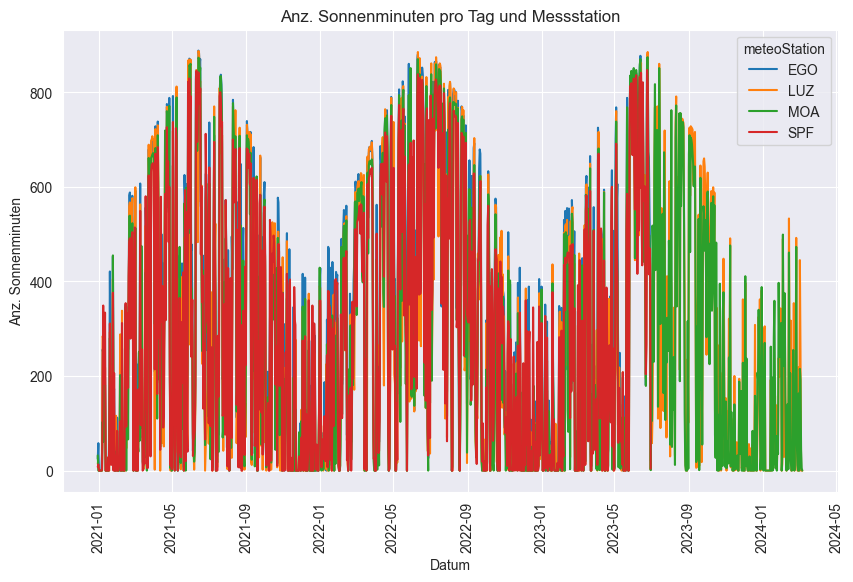

In [3]:
df_sun = pd.read_sql_query("SELECT SUM(meteoData.value) as 'sunMinDay', meteoData.dataTime, meteoData.meteoParameter, meteoStation FROM  meteoData WHERE meteoParameter == 'sre000h0' GROUP BY meteoStation, strftime('%Y-%m-%d', meteoData.dataTime)", connection)
df_sun['dataTime'] = pd.to_datetime(df_sun['dataTime'], format='%Y-%m-%d %H:%M')

plt.figure(figsize=(10, 6))
testPlot = sns.lineplot(x='dataTime', y='sunMinDay', hue='meteoStation', data=df_sun).set(title='Anz. Sonnenminuten pro Tag und Messstation', xlabel='Datum', ylabel='Anz. Sonnenminuten')
plt.xticks(rotation=90)
plt.show()

Als nächstes werden die Sonnenminuten und Zählerdaten pro BFS-Nummer geladen. Bei den Zählerdaten handelt es sich immer um den Durchschnittsverbrauch pro Gemeinde pro Zähler. Damit sind die Gemeinden untereinander vergleichbar. Mit der BFS-Nummer und dem Datum lassen sich die Daten verknüpfen.

In [4]:
df_sun = pd.read_sql_query("SELECT * FROM sumSunMinutesPerDayBfsId", connection)
df_sun.head()

,sumSunDay,time,meteoParameter,bfsID,meteoStation
0,8.0,2020-12-30,sre000h0,1001,SPF
1,13.0,2020-12-31,sre000h0,1001,SPF
2,0.0,2021-01-01,sre000h0,1001,SPF
3,0.0,2021-01-02,sre000h0,1001,SPF
4,0.0,2021-01-03,sre000h0,1001,SPF


In [5]:
df_power = pd.read_sql_query("SELECT * FROM dailySumSmartmeterBfsId", connection)
df_power.head()

,avgKwhConsum,time,bfsID,lawCityName
0,1.695778,2020-12-31,1001,Doppleschwand
1,21.895927,2021-01-01,1001,Doppleschwand
2,22.447296,2021-01-02,1001,Doppleschwand
3,22.783563,2021-01-03,1001,Doppleschwand
4,23.926130,2021-01-04,1001,Doppleschwand


In [6]:
df_sunPower = pd.merge(df_sun, df_power, on=['time', 'bfsID'])
df_sunPower['time'] = pd.to_datetime(df_sunPower['time'], format='%Y-%m-%d')
df_sunPower.head()

,sumSunDay,time,meteoParameter,bfsID,meteoStation,avgKwhConsum,lawCityName
0,13.0,2020-12-31,sre000h0,1001,SPF,1.695778,Doppleschwand
1,0.0,2021-01-01,sre000h0,1001,SPF,21.895927,Doppleschwand
2,0.0,2021-01-02,sre000h0,1001,SPF,22.447296,Doppleschwand
3,0.0,2021-01-03,sre000h0,1001,SPF,22.783563,Doppleschwand
4,0.0,2021-01-04,sre000h0,1001,SPF,23.926130,Doppleschwand


### Erstanalyse am Beispiel der Gemeinde Meggen
Bevor eine Analyse über sämtliche Daten durchgeführt wird, wird die Gemeinde Meggen als Beispiel genommen. Es wird sichtbar, dass im Fall von Meggen drei Sonnenwerte fehlen. Diese müssen noch aufgefüllt werden um eine komplette Zeitreihe zu erhalten.

In [7]:
df_sunPowerMeggen = df_sunPower.query("bfsID == 1063").copy()
df_sunPowerMeggen.info()
df_sunPowerMeggen.head()

<class 'pandas.core.frame.DataFrame'>
Index: 1161 entries, 32840 to 34000
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   sumSunDay       1158 non-null   float64       
 1   time            1161 non-null   datetime64[ns]
 2   meteoParameter  1161 non-null   object        
 3   bfsID           1161 non-null   int64         
 4   meteoStation    1161 non-null   object        
 5   avgKwhConsum    1161 non-null   float64       
 6   lawCityName     1161 non-null   object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(3)
memory usage: 72.6+ KB


,sumSunDay,time,meteoParameter,bfsID,meteoStation,avgKwhConsum,lawCityName
32840,9.0,2020-12-31,sre000h0,1063,LUZ,1.960185,Meggen
32841,0.0,2021-01-01,sre000h0,1063,LUZ,21.280028,Meggen
32842,0.0,2021-01-02,sre000h0,1063,LUZ,22.015781,Meggen
32843,0.0,2021-01-03,sre000h0,1063,LUZ,22.704968,Meggen
32844,0.0,2021-01-04,sre000h0,1063,LUZ,23.950467,Meggen


Zuerst aber eine Grafik, welche auf der linken y-Achse wird der Verbrauch dargestellt und rechts die Sonnenminute. Bei der Betrachtung des Stromverbrauches erkennt man ebenfalls eine Saisonalität. Im Winter steigt der durchschnittliche Stromverbrauch und im Sommer nimmt dieser ab. Im Gegensatz zu der Sonne, welche zeitweise den Boden nicht erreicht (min = 0), wird permanent Strom verbraucht und ist nie 0.

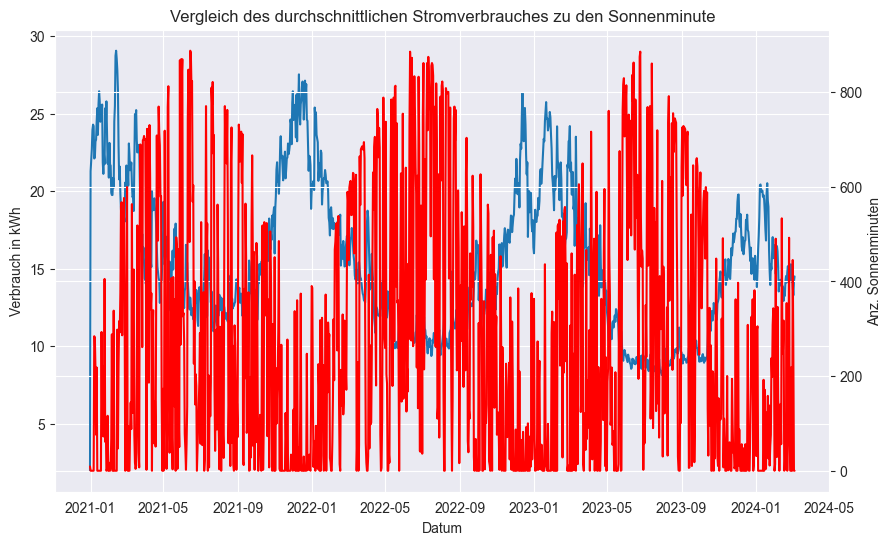

In [8]:
meggenPlot, ax1 = plt.subplots(figsize=(10, 6))
sns.lineplot(x='time', y='avgKwhConsum', data=df_sunPowerMeggen, ax=ax1).set(title='Vergleich des durchschnittlichen Stromverbrauches zu den Sonnenminute', xlabel='Datum', ylabel='Verbrauch in kWh')
ax2 = ax1.twinx()
sns.lineplot(data=df_sunPowerMeggen, x='time', y='sumSunDay', ax=ax2, color='red').set(ylabel='Anz. Sonnenminuten')
plt.xticks(rotation=90)
plt.show()

Für den Umgang mit den NA Werten, werden zunächst die unnötigen Spalten entfernt und kontrolliert, ob jedes Datum vorhanden ist.

In [9]:
df_meggen = df_sunPowerMeggen.copy()
df_meggen.drop(columns=['meteoParameter', 'meteoStation', 'bfsID', 'lawCityName'], inplace=True)
df_meggen['time'] = pd.to_datetime(df_meggen['time'])
print('Fehlende Datum: ', pd.date_range(start = '2020-12-31', end='2024-03-05').difference(df_meggen['time']))

Fehlende Datum:  DatetimeIndex([], dtype='datetime64[ns]', freq='D')


Für die spätere Kontrolle wie gut die Werte, zu den erzeugten Werten passen, wird eine Spalte erzeugt mit fehlenden Werten. Die fehlende Werte in der echten Spalten müssen entfernt werden, damit die spätere Kontrolle mit dem R-Squared funktioniert.

In [10]:
df_meggen.set_index('time', inplace=True)
df_meggen.dropna(inplace=True)
df_meggen['sumSunDayRef'] = df_meggen['sumSunDay']
df_meggen['sumSunDayRef'] = df_meggen['sumSunDayRef'].sample(frac=0.85)
df_meggen.info()
df_meggen.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1158 entries, 2020-12-31 to 2024-03-05
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   sumSunDay     1158 non-null   float64
 1   avgKwhConsum  1158 non-null   float64
 2   sumSunDayRef  984 non-null    float64
dtypes: float64(3)
memory usage: 36.2 KB


,sumSunDay,avgKwhConsum,sumSunDayRef
time,,,
2020-12-31,9.0,1.960185,9.0
2021-01-01,0.0,21.280028,0.0
2021-01-02,0.0,22.015781,0.0
2021-01-03,0.0,22.704968,0.0
2021-01-04,0.0,23.950467,0.0


Nun werden verschiedene Methoden angewandt, die fehlenden Werte der Referenz-Spalte zu füllen. In der Übersicht erkennt man, dass jede Spalte, bis auf die Referenzspalte, eine vollständige Spalte besitzt.

In [11]:
df_meggen = df_meggen.assign(FillMean=df_meggen.sumSunDayRef.fillna(df_meggen.sumSunDayRef.mean()))
df_meggen = df_meggen.assign(FillMedian=df_meggen.sumSunDayRef.fillna(df_meggen.sumSunDayRef.median()))
df_meggen = df_meggen.assign(RollingMean=df_meggen.sumSunDayRef.fillna(df_meggen.sumSunDayRef.rolling(24, min_periods=1).mean()))
df_meggen = df_meggen.assign(RollingMedian=df_meggen.sumSunDayRef.fillna(df_meggen.sumSunDayRef.rolling(24, min_periods=1).median()))
df_meggen = df_meggen.assign(InterpolationLinear=df_meggen.sumSunDayRef.interpolate(method='linear'))
df_meggen = df_meggen.assign(InterpolationQuadratic=df_meggen.sumSunDayRef.interpolate(method='quadratic'))
df_meggen = df_meggen.assign(InterpolationCubic=df_meggen.sumSunDayRef.interpolate(method='cubic'))
df_meggen = df_meggen.assign(InterpolationSLinear=df_meggen.sumSunDayRef.interpolate(method='slinear'))
df_meggen = df_meggen.assign(InterpolationAkima=df_meggen.sumSunDayRef.interpolate(method='akima'))
df_meggen = df_meggen.assign(InterpolationPoly5=df_meggen.sumSunDayRef.interpolate(method='polynomial', order=5))
df_meggen = df_meggen.assign(InterpolationPoly7=df_meggen.sumSunDayRef.interpolate(method='polynomial', order=7))
df_meggen = df_meggen.assign(InterpolationSpline3=df_meggen.sumSunDayRef.interpolate(method='spline', order=3))
df_meggen = df_meggen.assign(InterpolationSpline4=df_meggen.sumSunDayRef.interpolate(method='spline', order=4))
df_meggen = df_meggen.assign(InterpolationSpline5=df_meggen.sumSunDayRef.interpolate(method='spline', order=5))
df_meggen.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1158 entries, 2020-12-31 to 2024-03-05
Data columns (total 17 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   sumSunDay               1158 non-null   float64
 1   avgKwhConsum            1158 non-null   float64
 2   sumSunDayRef            984 non-null    float64
 3   FillMean                1158 non-null   float64
 4   FillMedian              1158 non-null   float64
 5   RollingMean             1158 non-null   float64
 6   RollingMedian           1158 non-null   float64
 7   InterpolationLinear     1158 non-null   float64
 8   InterpolationQuadratic  1158 non-null   float64
 9   InterpolationCubic      1158 non-null   float64
 10  InterpolationSLinear    1158 non-null   float64
 11  InterpolationAkima      1158 non-null   float64
 12  InterpolationPoly5      1158 non-null   float64
 13  InterpolationPoly7      1158 non-null   float64
 14  InterpolationSpline3  

Die Kontrolle mit der R-Squared Methode legt nahe, dass die Lineare-Methode am nächsten den realen Werten Nahe kommt. Aus diesem Grund wird mit dieser Methode die NA-Werte aufgefüllt. Bei lediglich 3 fehlenden Werten, stellt dies kein weiteres Problem dar.

In [12]:
results = [(method, r2_score(df_meggen.sumSunDay, df_meggen[method])) for method in list(df_meggen)[3:]]
results_df = pd.DataFrame(np.array(results), columns=['Method', 'R_squared'])
results_df.sort_values(by='R_squared', ascending=False)

,Method,R_squared
4,InterpolationLinear,0.9085610600362907
7,InterpolationSLinear,0.9085610600362907
8,InterpolationAkima,0.899984962024761
2,RollingMean,0.8925696558741977
5,InterpolationQuadratic,0.8740092453073754
0,FillMean,0.8737862599107434
6,InterpolationCubic,0.8706588740645101
11,InterpolationSpline3,0.8703356776497615
1,FillMedian,0.8702570928568235
3,RollingMedian,0.8680898063072886


Beim Laden derselben Daten, werden die Daten nun mit der Linearen Interpolation aufgefüllt. Die Kontrolle zeigt, dass dies funktioniert hat. <br>
Als nächstes wird die Korrelation in Meggen betrachtet. Die Zeit-Spalte wird als Index verwendet. Mit einer Korrelation von -0.51 wird ein schwacher negativer Zusammenhang zwischen den Sonnenminuten und des Stromverbrauches bestätigt. Das bedeutet, je mehr Sonnenschein, desto tiefer der Stromverbrauch. Mehr Sonnenschein bedeuetet normalerweise auch höhere Temperaturen. Diese Analyse folgt in einem späteren Kapitel.<br>
Die Autocorrelation gibt anhand verschiedener Intervall an, wie stark die Werte von vorhergehenden Punkten in derselben Zeitreihe beeinflusst werden. Bei den Sonnenminuten gibt es keine regelmässigkeiten. Beim Strom sieht es anders aus. Mit jedem erweitern des Intervalls nimmt die Korrelation ab. Besonders bei 90-Tagen. Bei einem 1-Jahres Intervall ist die Korrelation wieder hoch. So kann zumindest angenommen werden, dass beim Strom eine wöchentliche und jährliche Korrelation besteht.


In [13]:
df_meggen = df_sunPowerMeggen.copy()
df_meggen.drop(columns=['meteoParameter', 'meteoStation', 'bfsID', 'lawCityName'], inplace=True)
df_meggen['time'] = pd.to_datetime(df_meggen['time'])
df_meggen.sumSunDay.interpolate(method='linear', inplace=True)

#df_test = df_test.astype({'time': str})
df_meggen.index = df_meggen['time']
#df_test = df_test.astype({'sumSunDay': str})
df_meggen.drop(columns=['time'], inplace=True)
df_meggen.info()
df_meggen.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1161 entries, 2020-12-31 to 2024-03-05
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   sumSunDay     1161 non-null   float64
 1   avgKwhConsum  1161 non-null   float64
dtypes: float64(2)
memory usage: 27.2 KB


/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_44904/3905778183.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_meggen.sumSunDay.interpolate(method='linear', inplace=True)


,sumSunDay,avgKwhConsum
time,,
2020-12-31,9.0,1.960185
2021-01-01,0.0,21.280028
2021-01-02,0.0,22.015781
2021-01-03,0.0,22.704968
2021-01-04,0.0,23.950467


In [14]:
print('Korrelation zwischen den Parametern:\n', df_meggen.corr())
print('\nAutocorrelation der täglichen Sonnenminuten und Stromverbrauch:')
autocorrOneSun = df_meggen['sumSunDay'].autocorr(lag=1)
print('Sonne 1-Tages-Intervall:\t', autocorrOneSun)
autocorrOneKwh = df_meggen['avgKwhConsum'].autocorr(lag=1)
print('Strom 1-Tages-Intervall:\t', autocorrOneKwh)
autocorr7Sun = df_meggen['sumSunDay'].autocorr(lag=7)
print('Sonne 7-Tages-Intervall:\t', autocorr7Sun)
autocorr7Kwh = df_meggen['avgKwhConsum'].autocorr(lag=7)
print('Strom 7-Tages-Intervall:\t', autocorr7Kwh)
autocorr30Sun = df_meggen['sumSunDay'].autocorr(lag=30)
print('Sonne 30-Tages-Intervall:\t', autocorr30Sun)
autocorr30Kwh = df_meggen['avgKwhConsum'].autocorr(lag=30)
print('Strom 30-Tages-Intervall:\t', autocorr30Kwh)

autocorr90Sun = df_meggen['sumSunDay'].autocorr(lag=90)
print('Sonne 90-Tages-Intervall:\t', autocorr90Sun)
autocorr90Kwh = df_meggen['avgKwhConsum'].autocorr(lag=90)
print('Strom 90-Tages-Intervall:\t', autocorr90Kwh)

autocorr365Sun = df_meggen['sumSunDay'].autocorr(lag=365)
print('Sonne 365-Tages-Intervall:\t', autocorr365Sun)
autocorr365Kwh = df_meggen['avgKwhConsum'].autocorr(lag=365)
print('Strom 365-Tages-Intervall:\t', autocorr365Kwh)

Korrelation zwischen den Parametern:
               sumSunDay  avgKwhConsum
sumSunDay      1.000000     -0.504989
avgKwhConsum  -0.504989      1.000000

Autocorrelation der täglichen Sonnenminuten und Stromverbrauch:
Sonne 1-Tages-Intervall:	 0.5863607423619308
Strom 1-Tages-Intervall:	 0.9651726141971511
Sonne 7-Tages-Intervall:	 0.2418417673790632
Strom 7-Tages-Intervall:	 0.8771611701127411
Sonne 30-Tages-Intervall:	 0.21043259424765393
Strom 30-Tages-Intervall:	 0.7429401085070645
Sonne 90-Tages-Intervall:	 -0.018353064166448455
Strom 90-Tages-Intervall:	 0.05242564931410308
Sonne 365-Tages-Intervall:	 0.22732149828669854
Strom 365-Tages-Intervall:	 0.7440277259300015


### Ausweitung der Analyse auf alle Gemeinden
Im nächsten Schritt wird die Korrelation-Analyse auf die weiteren Gemeinden ausgeweitet. Dazu wird die Analyse in West und Ost unterteilt, dies aufgrund der geografischen Standorte der Messstationen. Bei den westlichen Gemeinde werden die Daten bis zum 30.6.2024 verwendet.

In [15]:
df_west = df_sunPower.query("meteoStation == 'SPF' | meteoStation == 'EGO'")
df_east = df_sunPower.query("meteoStation == 'LUZ' | meteoStation == 'MOA'")
df_west.info()
df_east.info()
df_west = df_west.copy()
df_west.head()
df_east = df_east.copy()
df_east.head()
df_west.drop(columns=['meteoParameter', 'meteoStation', 'lawCityName'], inplace=True)
df_west['time'] = pd.to_datetime(df_west['time'])
#df_west.dropna(inplace=True)
df_westPivot = df_west.pivot(index='time', columns=['bfsID'], values=['avgKwhConsum', 'sumSunDay'])
df_westPivot.info()

df_east.drop(columns=['meteoParameter', 'meteoStation', 'lawCityName'], inplace=True)
df_east['time'] = pd.to_datetime(df_east['time'])
#df_east.dropna(inplace=True)
df_eastPivot = df_east.pivot(index='time', columns='bfsID', values=['avgKwhConsum', 'sumSunDay'])
df_eastPivot.info()

<class 'pandas.core.frame.DataFrame'>
Index: 36449 entries, 0 to 74734
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   sumSunDay       36449 non-null  float64       
 1   time            36449 non-null  datetime64[ns]
 2   meteoParameter  36449 non-null  object        
 3   bfsID           36449 non-null  int64         
 4   meteoStation    36449 non-null  object        
 5   avgKwhConsum    36449 non-null  float64       
 6   lawCityName     36449 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(3)
memory usage: 2.2+ MB
<class 'pandas.core.frame.DataFrame'>
Index: 38286 entries, 7296 to 54701
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   sumSunDay       38223 non-null  float64       
 1   time            38286 non-null  datetime64[ns]
 2   meteoParameter  38286 non-nul

In [16]:
df_eastPivot.interpolate(method='linear', inplace=True)
df_eastPivot.info()
df_westPivot.interpolate(method='linear', inplace=True)
df_westPivot.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1162 entries, 2020-12-31 to 2024-03-06
Data columns (total 66 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   (avgKwhConsum, 1021)  1162 non-null   float64
 1   (avgKwhConsum, 1023)  1162 non-null   float64
 2   (avgKwhConsum, 1024)  1162 non-null   float64
 3   (avgKwhConsum, 1025)  1162 non-null   float64
 4   (avgKwhConsum, 1026)  1162 non-null   float64
 5   (avgKwhConsum, 1030)  1162 non-null   float64
 6   (avgKwhConsum, 1031)  1162 non-null   float64
 7   (avgKwhConsum, 1032)  1162 non-null   float64
 8   (avgKwhConsum, 1033)  1162 non-null   float64
 9   (avgKwhConsum, 1037)  1162 non-null   float64
 10  (avgKwhConsum, 1039)  1162 non-null   float64
 11  (avgKwhConsum, 1040)  1162 non-null   float64
 12  (avgKwhConsum, 1041)  1162 non-null   float64
 13  (avgKwhConsum, 1051)  1162 non-null   float64
 14  (avgKwhConsum, 1052)  1162 non-null   float64
 15  (av

Für eine bessere optische Ansicht wird mit den Korrelation-Werten eine Heatmap erstellt. Zuerst für die östliche Seite. Was sofort auffällt sind die beiden dunklen Vierecke. Unten rechts sind die Korrelationen zwischen den Sonnenminuten zwischen den Gemeinden. Diese Werte sind sehr hoch. Somit scheint die Sonne vielerorts gleichzeitig und unterscheidet sich im Schnitt pro Tag nicht sehr stark. Oben links befinden sich die Korrelationen zwischen den Gemeinden und des Stromverbrauchs. Vielfach verhaltet sich der Stromverbrauch ähnlich zu den Gemeinden. Es gibt aber einige Ausreisser. Dies kann mit den aussergewöhnlichen Anomalien Zusammenhängen, welche bei einigen Ortschaften in der ersten Analyse erkannt wurden. Dies ist z.B. bei der Gemeinde Kriens (plz=6010/BFS-Nummer=1059). Die verbleibenden Quadranten geben die Korrelation zwischen dem Stromverbrauch und den Sonnenminuten an. Was sich bei Meggen angedeutet hat lässt sich mit der Heatmap bestätigen. Die Korrelation liegt im Bereich von ca. -0.5. Ausser bei denen, welche bereits eine schwache Korrelation bei den Zählerdaten vorweisen. Dort geht die Korrelation noch weiter zurück bis gegen 0.

Korrelation zwischen den Parametern:
                    avgKwhConsum                                          \
bfsID                      1021      1023      1024      1025      1026   
             bfsID                                                        
avgKwhConsum 1021      1.000000  0.898948  0.885427  0.873600  0.900943   
             1023      0.898948  1.000000  0.774728  0.691152  0.784962   
             1024      0.885427  0.774728  1.000000  0.903307  0.948286   
             1025      0.873600  0.691152  0.903307  1.000000  0.940738   
             1026      0.900943  0.784962  0.948286  0.940738  1.000000   
...                         ...       ...       ...       ...       ...   
sumSunDay    1093     -0.400586 -0.310518 -0.440329 -0.468070 -0.468293   
             1097     -0.425200 -0.329132 -0.459550 -0.492037 -0.488727   
             1098     -0.400586 -0.310518 -0.440329 -0.468070 -0.468293   
             1100     -0.427815 -0.331976 -0.460080 -0.492589 

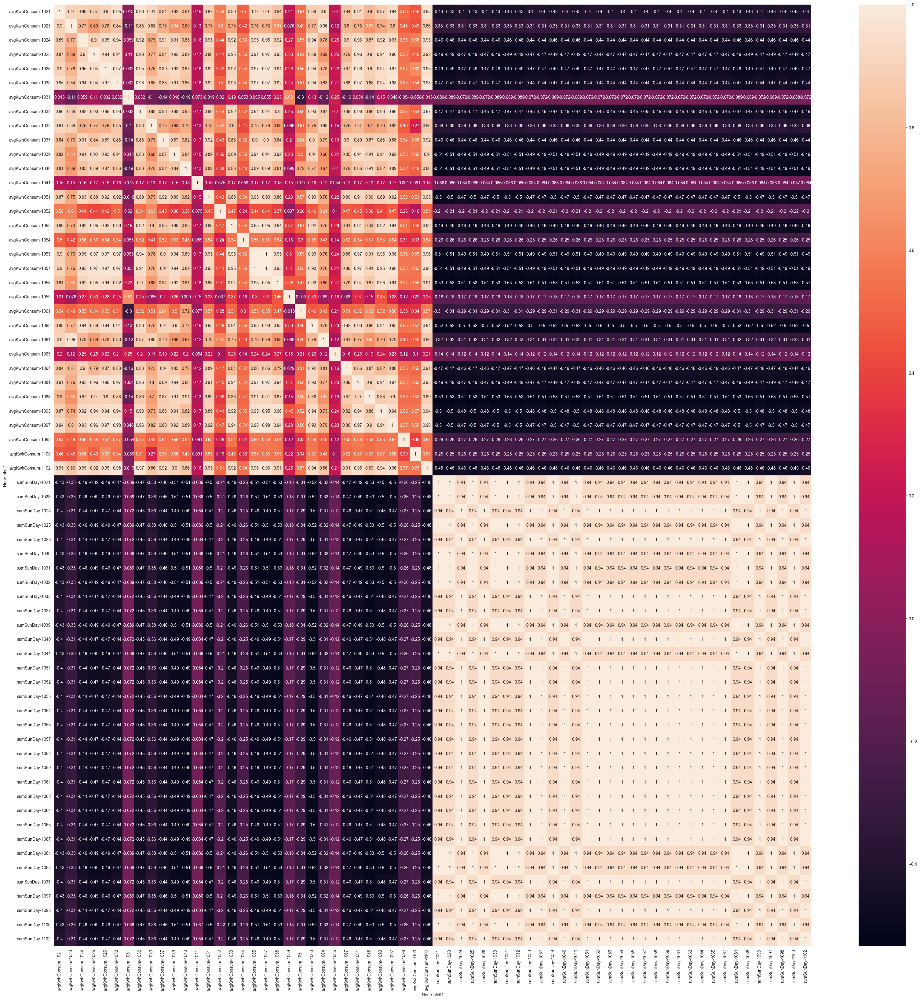

In [17]:
print('Korrelation zwischen den Parametern:\n', df_eastPivot.corr())

fig = plt.figure(figsize=(40, 40))
sns.heatmap(df_eastPivot.corr(), annot=True)
plt.show()

Die westliche Seite präsentiert sich in einem ähnlichen Gewand.

Korrelation zwischen den Parametern:
                    avgKwhConsum                                          \
bfsID                      1021      1023      1024      1025      1026   
             bfsID                                                        
avgKwhConsum 1021      1.000000  0.898948  0.885427  0.873600  0.900943   
             1023      0.898948  1.000000  0.774728  0.691152  0.784962   
             1024      0.885427  0.774728  1.000000  0.903307  0.948286   
             1025      0.873600  0.691152  0.903307  1.000000  0.940738   
             1026      0.900943  0.784962  0.948286  0.940738  1.000000   
...                         ...       ...       ...       ...       ...   
sumSunDay    1093     -0.400586 -0.310518 -0.440329 -0.468070 -0.468293   
             1097     -0.425200 -0.329132 -0.459550 -0.492037 -0.488727   
             1098     -0.400586 -0.310518 -0.440329 -0.468070 -0.468293   
             1100     -0.427815 -0.331976 -0.460080 -0.492589 

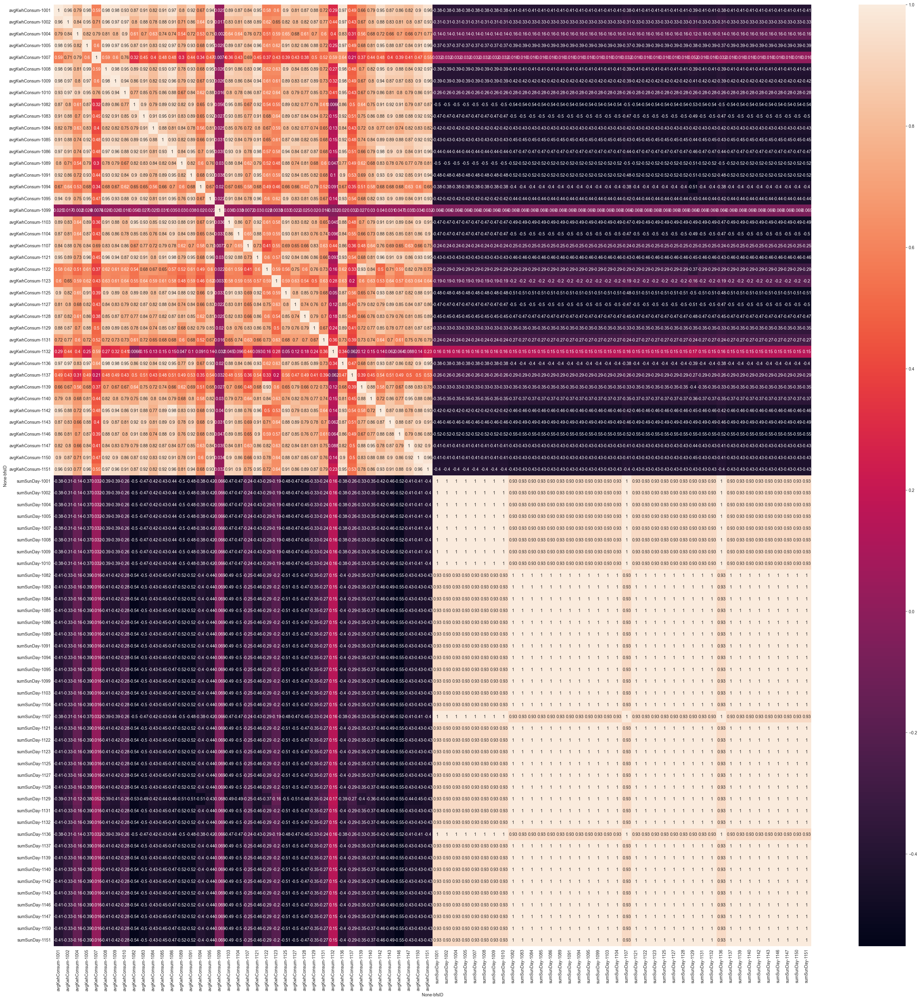

In [18]:
print('Korrelation zwischen den Parametern:\n', df_eastPivot.corr())

fig = plt.figure(figsize=(40, 40))
sns.heatmap(df_westPivot.corr(), annot=True)
plt.show()

Um die Korrelationen innerhalb der Zeitreihe noch besser einschätzen zu können, wird ein Boxplot erstellt.

In [19]:
columns = list(df_westPivot)
columns = list(df_eastPivot)

autocorrOneDay = []

#1 Day Correlation
for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=1)
    col1 = column[0]+ 'OneDay'
    autocorrOneDay.append([col1,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=1)
    col1 = column[0]+ 'OneDay'
    autocorrOneDay.append([col1,column[1],autocorrOneSun])
#7 Day Correlation
for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=7)
    col7 = column[0]+ '7Day'
    autocorrOneDay.append([col7,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=7)
    col7 = column[0]+ '7Day'
    autocorrOneDay.append([col7,column[1],autocorrOneSun])

#30 Day Correlation
for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=30)
    col30 = column[0]+ '30Day'
    autocorrOneDay.append([col30,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=30)
    col30 = column[0]+ '30Day'
    autocorrOneDay.append([col30,column[1],autocorrOneSun])

for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=90)
    col90 = column[0]+ '90Day'
    autocorrOneDay.append([col90,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=90)
    col90 = column[0]+ '90Day'
    autocorrOneDay.append([col90,column[1],autocorrOneSun])

for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=365)
    col365 = column[0]+ '365Day'
    autocorrOneDay.append([col365,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=365)
    col365 = column[0]+ '365Day'
    autocorrOneDay.append([col365,column[1],autocorrOneSun])

df = pd.DataFrame(autocorrOneDay)
df = df.pivot(index=1, columns=0, values=2)
df.head()

,avgKwhConsum30Day,avgKwhConsum365Day,avgKwhConsum7Day,avgKwhConsum90Day,avgKwhConsumOneDay,sumSunDay30Day,sumSunDay365Day,sumSunDay7Day,sumSunDay90Day,sumSunDayOneDay
1,,,,,,,,,,
1001,0.667101,0.779139,0.810216,-0.004348,0.951492,0.18459,0.158684,0.273196,0.016199,0.593869
1002,0.606966,0.680825,0.752144,0.032680,0.937982,0.18459,0.158684,0.273196,0.016199,0.593869
1004,0.515631,0.579207,0.739573,0.000183,0.915557,0.18459,0.158684,0.273196,0.016199,0.593869
1005,0.703554,0.827965,0.837596,-0.003933,0.962068,0.18459,0.158684,0.273196,0.016199,0.593869
1007,0.162847,0.417719,0.375962,-0.058252,0.905284,0.18459,0.158684,0.273196,0.016199,0.593869


Im Boxplot setzt sich die Erkenntnis von Meggen weiter. Das 90-Tag Intervall ist nicht relevant. Während die sonst gewählten Intervall eine höhere Korrelation vorweisen. So korreliert der Stromverbrauch bei 50% der Gemeinden mit dem Wert von 0.74 zum vor jährlichen Tagesschnitt. Im Bereich der Sonnenminuten gibt es keine bedeutende Korrelation.

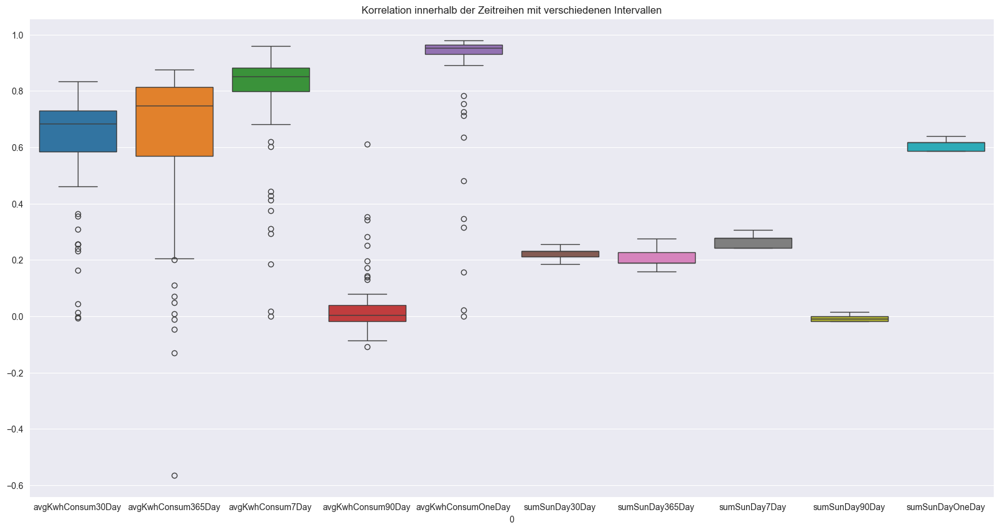

,avgKwhConsum30Day,avgKwhConsum365Day,avgKwhConsum7Day,avgKwhConsum90Day,avgKwhConsumOneDay,sumSunDay30Day,sumSunDay365Day,sumSunDay7Day,sumSunDay90Day,sumSunDayOneDay
count,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000
mean,0.598349,0.612034,0.773460,0.036874,0.876082,0.222881,0.210065,0.270804,-0.006317,0.607774
std,0.209915,0.299463,0.206756,0.109891,0.213413,0.020890,0.037125,0.020583,0.010830,0.017493
min,-0.006656,-0.564617,-0.001339,-0.107675,-0.001111,0.184590,0.158684,0.242569,-0.017253,0.586753
25%,0.584245,0.569482,0.798387,-0.017943,0.930055,0.211133,0.188957,0.242569,-0.017253,0.586753
50%,0.682962,0.748106,0.850890,0.003293,0.953881,0.231780,0.188957,0.277336,-0.009245,0.616811
75%,0.730617,0.814225,0.882031,0.038919,0.964267,0.231780,0.227312,0.277336,0.000677,0.616811
max,0.833440,0.876844,0.960128,0.610346,0.980169,0.255679,0.276362,0.307346,0.016199,0.638860


In [20]:
fig = plt.figure(figsize=(20, 10))
sns.boxplot(df).set(title='Korrelation innerhalb der Zeitreihen mit verschiedenen Intervallen')
plt.show()
df.describe()

Für den Boxplot der Korrelationen zwischen den Parametern werden normale Korrelationsmatrixen erstellt und die nicht notwendigen Index und Spalten entfernt.

In [21]:
df_corrWest = df_westPivot[['avgKwhConsum', 'sumSunDay']].corr()
df_corrWest.drop(columns=['sumSunDay'], index=['avgKwhConsum'],inplace=True)
df_corrEast = df_eastPivot[['avgKwhConsum', 'sumSunDay']].corr()
df_corrEast.drop(columns=['sumSunDay'], index=['avgKwhConsum'],inplace=True)

Der Boxplot für den westlichen Teil zeigt das 75% der Korrelationswerte tiefer als ca. -0.3 sind, also eine stärkere Korrelation aufweisen. Wobei nur 25% der Korrelation zwischen ca. -0.475 und ca. -0.55 liegen. Der östliche Teil hat weniger Outlier und das 75% Quantil ein wenig früher bei ca. -0.29 startet. Generll gibt somit keine starke Verbindung zwischen diesen zwei Parametern.

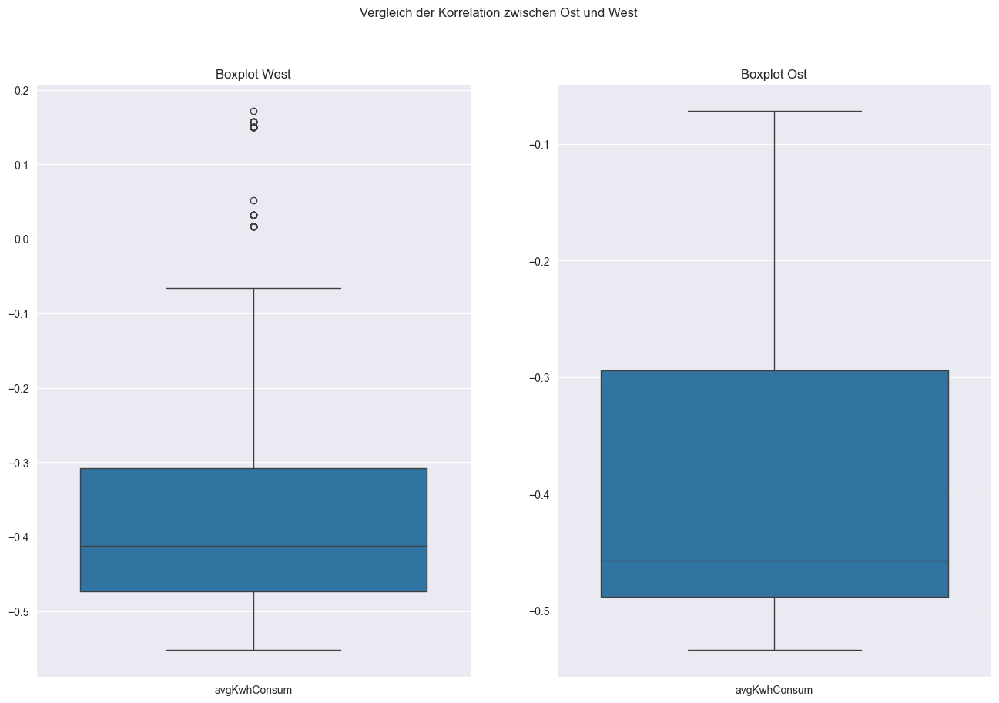

avgKwhConsum                                                         \
bfsID         1021       1023       1024       1025       1026       1030   
count    33.000000  33.000000  33.000000  33.000000  33.000000  33.000000   
mean     -0.409616  -0.317373  -0.447335  -0.476802  -0.475709  -0.452643   
std       0.012139   0.009222   0.009411   0.011731   0.009963   0.011621   
min      -0.427815  -0.331976  -0.460080  -0.492589  -0.488727  -0.469881   
25%      -0.425200  -0.329132  -0.459550  -0.492037  -0.488727  -0.467582   
50%      -0.400586  -0.310518  -0.440329  -0.468070  -0.468293  -0.443998   
75%      -0.400586  -0.310518  -0.440329  -0.468070  -0.468293  -0.443998   
max      -0.400586  -0.310518  -0.440329  -0.468070  -0.468293  -0.443998   

                                                   ...                        \
bfsID       1031       1032       1033       1037  ...       1064       1065   
count  33.000000  33.000000  33.000000  33.000000  ...  33.000000  33.000000   
mean   -0.078155  -0.454563  -0.366789  -0.445691  ...  -0.315320  -0.127535   
std     0.008322   0.009184   0.011145   0.007728  ...   0.007177   0.010575   
min    -0.089079  -0.469251  -0.382451  -0.455800  ...  -0.326553  -0.141438   
25%    -0.089079  -0.466259  -0.381200  -0.455800  ...  -0.324486  -0.141438   
50%    -0.071961  -0.447737  -0.358494  -0.439939  ...  -0.309984  -0.119666   
75%    -0.071961  -0.447737  -0.358494  -0.439939  ...  -0.309984  -0.119666   
max    -0.071961  -0.447737  -0.358494  -0.439939  ...  -0.309984  -0.119666   

                                                                         \
bfsID       1067       1081       1088       1093       1097       1098   
count  33.000000  33.000000  33.000000  33.000000  33.000000  33.000000   
mean   -0.461089  -0.480570  -0.519342  -0.485833  -0.483683  -0.264517   
std     0.005340   0.009336   0.010771   0.011164   0.012009   0.002451   
min    -0.469548  -0.493178  -0.533917  -0.501327  -0.502068  -0.266337   
25%    -0.467899  -0.492690  -0.533324  -0.500288  -0.499063  -0.266337   
50%    -0.457119  -0.473621  -0.511325  -0.477524  -0.474752  -0.266337   
75%    -0.457119  -0.473621  -0.511325  -0.477524  -0.474752  -0.261244   
max    -0.457119  -0.473621  -0.511325  -0.477524  -0.474752  -0.261244   

                             
bfsID       1100       1102  
count  33.000000  33.000000  
mean   -0.254296  -0.469452  
std     0.000504   0.010670  
min    -0.254436  -0.485082  
25%    -0.254436  -0.483187  
50%    -0.254356  -0.461513  
75%    -0.254356  -0.461513  
max    -0.251499  -0.461513  

[8 rows x 33 columns]

In [22]:
fig, axes = plt.subplots(1, 2, figsize=(16,10))
fig.suptitle('Vergleich der Korrelation zwischen Ost und West')
sns.boxplot(ax = axes[0], data=df_corrWest).set(title='Boxplot West')
sns.boxplot(ax = axes[1], data=df_corrEast).set(title='Boxplot Ost')
plt.show()
df_corrWest.describe()
df_corrEast.describe()

Abschliessend kann gesagt werden, dass die Sonne wohl keinen direkten Einfluss auf den Stromverbrauch hat.

## Mögliche Analyse Solarpanels, Stromverbrauch während Sonnenzeit und während Sonne weg ist 
## Mögliche Analyse Zusammenhang des Zubaus von Solaranlagen und dem Trend des Rückgangs des Stromverbrauches über die restlichen drei Jahren.



## Datenanalyse Smartmeter mit Regendaten
Als nächster Schritt in der Analyse werden die Regendaten verwendet. In der Analyse wurde bereits festgestellt, dass die Daten nicht vollständig sind. In dieser Grafik ist gleich erkennbar, dass es da gewisse Ausschläge gibt, die nicht normal erscheinen. Für eine bessere Übersicht folgt später ein Facet Grid für jeden Standort. Die geladenen Daten beinhalten die aufsummierten Niederschläge in mm pro Tag und BFS-Nummer.

In [6]:
df_rain = pd.read_sql_query("SELECT * FROM sumRainPerDayBfsId", connection)
df_rain[['dataTime', 'hour']] = df_rain['dataTime'].str.split(' ', expand=True)
df_rain['dataTime'] = pd.to_datetime(df_rain['dataTime'], format='%Y-%m-%d')
df_rain.drop(columns=['hour'], inplace=True)
df_rain.rename(columns={'dataTime':'time'}, inplace=True)
print(df_rain.count())
df_rain.head()

rainSumDay        89593
time              91581
meteoParameter    91581
bfsID             91581
meteoStation      91581
dtype: int64


,rainSumDay,time,meteoParameter,bfsID,meteoStation
0,3.0,2020-12-30,rre150h0,1001,ZELUFT
1,0.3,2020-12-31,rre150h0,1001,ZELUFT
2,3.8,2021-01-01,rre150h0,1001,ZELUFT
3,0.0,2021-01-02,rre150h0,1001,ZELUFT
4,0.6,2021-01-03,rre150h0,1001,ZELUFT


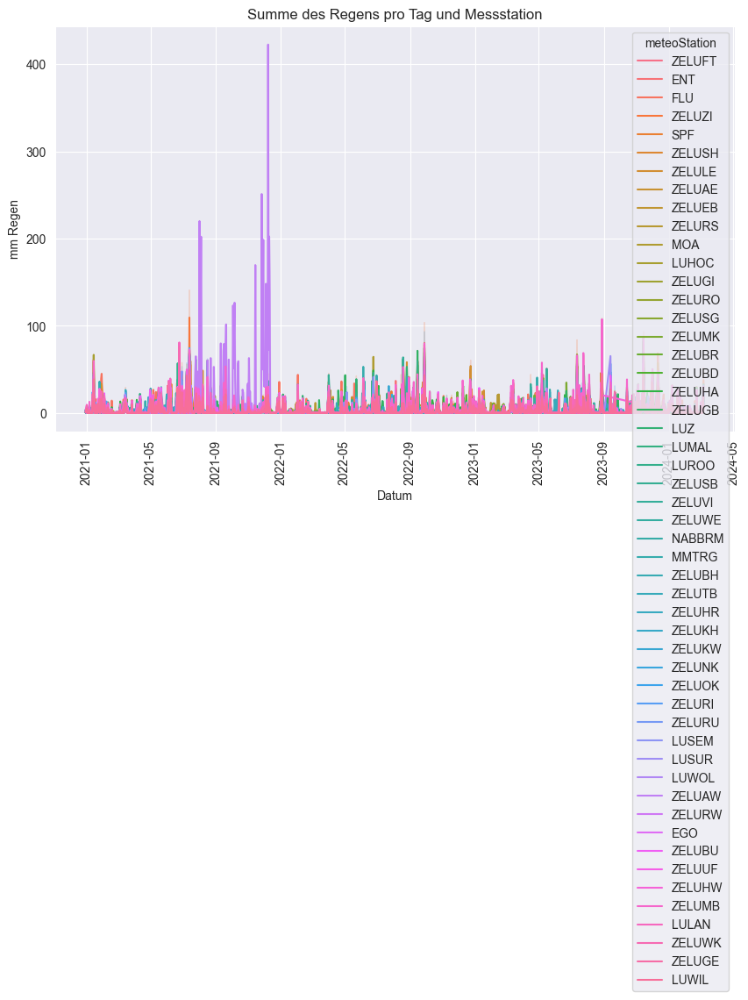

In [7]:
plt.figure(figsize=(10, 6))
testPlot = sns.lineplot(x='time', y='rainSumDay', hue='meteoStation', data=df_rain).set(title='Summe des Regens pro Tag und Messstation', xlabel='Datum', ylabel='mm Regen')
plt.xticks(rotation=90)
plt.show()

Damit die fehlenden Daten später besser analysiert werden können, wird eine Pivot Tabelle erstellt.

In [8]:
df_rainPivot = df_rain.pivot(index='time', columns=['bfsID'], values=['rainSumDay'])
df_rainPivot.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1163 entries, 2020-12-30 to 2024-03-06
Data columns (total 80 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   (rainSumDay, 1001)  1101 non-null   float64
 1   (rainSumDay, 1002)  1163 non-null   float64
 2   (rainSumDay, 1004)  1163 non-null   float64
 3   (rainSumDay, 1005)  1117 non-null   float64
 4   (rainSumDay, 1007)  1101 non-null   float64
 5   (rainSumDay, 1008)  1163 non-null   float64
 6   (rainSumDay, 1009)  1139 non-null   float64
 7   (rainSumDay, 1010)  1159 non-null   float64
 8   (rainSumDay, 1021)  1147 non-null   float64
 9   (rainSumDay, 1023)  1155 non-null   float64
 10  (rainSumDay, 1024)  1160 non-null   float64
 11  (rainSumDay, 1025)  1163 non-null   float64
 12  (rainSumDay, 1026)  1155 non-null   float64
 13  (rainSumDay, 1030)  1163 non-null   float64
 14  (rainSumDay, 1031)  1163 non-null   float64
 15  (rainSumDay, 1032)  1163 non-null   f

In [9]:
df_power = pd.read_sql_query("SELECT * FROM dailySumSmartmeterBfsId", connection)
df_power['time'] = pd.to_datetime(df_power['time'])

Um die Vollständigkeit zu prüfen, wird eine Pivot Tabelle erstellt und mit der Info-Ansicht werden diese erkennbar. Die meisten Werte sind vorhanden oder es fehlt einer. Eine Aussnahme ist die BFS-Nummer 1100 und 1129 welche 30 bzw. 32 fehlende Daten aufweist.

In [10]:
df_powerPivot = df_power.pivot(index='time', columns=['bfsID'], values=['avgKwhConsum'])
df_powerPivot.info()


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1162 entries, 2020-12-31 to 2024-03-06
Data columns (total 73 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   (avgKwhConsum, 1001)  1161 non-null   float64
 1   (avgKwhConsum, 1002)  1161 non-null   float64
 2   (avgKwhConsum, 1004)  1162 non-null   float64
 3   (avgKwhConsum, 1005)  1161 non-null   float64
 4   (avgKwhConsum, 1007)  1161 non-null   float64
 5   (avgKwhConsum, 1008)  1161 non-null   float64
 6   (avgKwhConsum, 1009)  1161 non-null   float64
 7   (avgKwhConsum, 1010)  1162 non-null   float64
 8   (avgKwhConsum, 1021)  1161 non-null   float64
 9   (avgKwhConsum, 1023)  1161 non-null   float64
 10  (avgKwhConsum, 1024)  1162 non-null   float64
 11  (avgKwhConsum, 1025)  1161 non-null   float64
 12  (avgKwhConsum, 1026)  1161 non-null   float64
 13  (avgKwhConsum, 1030)  1161 non-null   float64
 14  (avgKwhConsum, 1031)  1161 non-null   float64
 15  (av

Mit der Betrachtung der leeren Daten fällt auf, dass die Daten zu Beginn der Zeitreihe fehlen. Aus der Forecast Analyse wissen wir, dass sich der Stromverbrauch Saisonal verhält. Mit der Erkenntnis, dass sich der Stromverbrauch innerhalb des Monats stabil bewegt, wird die lineare Interpolation angewendet. Die Interpolation folgt zu einem späteren Zeitpunkt. Nachfolgend werden die Daten vorbereitet für die weitere Analyse.

In [11]:
df_powerPivotNa = df_powerPivot[df_powerPivot.isna().any(axis=1)]
df_powerPivotNa.head(1000)

avgKwhConsum                                              \
bfsID              1001       1002       1004       1005       1007   
time                                                                  
2020-12-31     1.695778   1.907807   2.436917   2.650554   1.528791   
2021-01-01    21.895927  17.801077  20.220615  23.538709  20.903226   
2021-01-02    22.447296  18.758618  18.284424  23.447896  21.380422   
2021-01-03    22.783563  18.726913  18.565640  24.511893  21.583592   
2021-01-04    23.926130  20.237471  19.457000  25.161400  21.906430   
2021-01-05    23.672693  20.290916  19.958800  24.183642  20.995257   
2021-01-06    23.268938  19.936138  20.953038  24.694349  21.546539   
2021-01-07    22.852722  19.509729  21.056816  24.218027  20.807299   
2021-01-08    22.965546  19.634889  21.358532  24.519106  21.562260   
2021-01-09    23.921626  20.316719  22.938585  25.950887  24.481243   
2021-01-10    23.644760  20.216942  21.892777  25.998158  23.802475   
2021-01-11    24.533304  20.759586  21.007731  25.999909  23.510057   
2021-01-12    23.862625  20.485355  19.689001  25.465483  22.215063   
2021-01-13    21.560123  18.730123  17.598254  22.845455  20.771599   
2021-01-14    21.693102  19.208218  18.014669  23.165914  20.425819   
2021-01-15    22.625826  19.924153  17.449688  24.276050  22.933815   
2021-01-16    23.735366  20.690167  21.635013  26.386626  23.565364   
2021-01-17    22.154984  19.223525  18.575337  24.439463  22.407718   
2021-01-18    22.163872  19.081975  18.219414  23.294197  22.499756   
2021-01-19    22.449643  19.406770  18.865611  24.576261  20.593269   
2021-01-20    21.643059  19.071020  16.886399  23.928324  20.151083   
2021-01-21    20.416704  18.114164  16.008644  22.288128  18.635757   
2021-01-22    19.635926  17.335217  17.604319  20.969200  18.581622   
2021-01-23    20.723613  18.407892  19.223441  23.488581  20.460774   
2021-01-24    20.154340  17.851900  18.527294  23.263399  20.220487   
2021-01-25    21.673735  19.364715  18.692009  23.847098  20.151158   
2021-01-26    22.145574  19.795488  18.279696  24.929997  21.728694   
2021-01-27    22.675902  19.791066  18.823848  25.061909  21.053057   
2021-01-28    20.072229  18.374112  17.102741  22.607850  19.315589   
2021-01-29    19.505232  17.884529  16.812282  21.778062  18.802072   
2021-01-30    19.447371  17.806464  18.688156  21.486778  19.398315   
2021-01-31    18.811874  16.435860  17.529351  21.080114  18.891168   
2021-02-05    18.223060  16.711244  16.914802  19.831563  17.173389   
2021-02-06    18.696138  16.899170  17.583107  20.515455  17.910272   
2021-02-07    19.605769  16.867821  17.223748  21.217472  18.172347   
2021-02-08    19.942885  17.253054  17.597139  21.295623  18.064432   
2021-02-09    21.258029  18.530690  17.989927  22.706343  18.940315   
2021-02-13    26.589290  23.631391  24.077737  29.737691  28.426615   
2021-02-15    23.401985  20.960265  21.369791  25.728567  23.040289   
2021-02-16    19.836032  17.665656  18.246076  21.356349  18.442409   
2021-02-17    18.653157  17.077586  18.181637  19.987223  17.633743   
2021-02-18    19.495582  17.118398  17.860072  21.024117  18.041562   
2021-02-19    17.835631  16.038609  17.273825  19.185172  17.111019   
2021-02-20    17.807771  16.004332  17.836339  18.848309  18.176126   
2021-02-21    17.191270  15.316395  16.589065  18.411411  16.811281   
2024-03-06          NaN        NaN   1.329288        NaN        NaN   

                                                                   ...  \
bfsID            1008       1009       1010       1021       1023  ...   
time                                                               ...   
2020-12-31   3.065394   1.648554   2.365513   2.121565   2.908474  ...   
2021-01-01  20.479602  18.681705  20.468762  24.785563  31.086677  ...   
2021-01-02  20.677542  19.088684  20.492545  27.005302  33.791567  ...   
2021-01-03  21.111326  19.504651  20.654174  26.860290  35.044798  ...   
2021-01-04  2

In [12]:
df_rainPower = pd.merge(df_rain, df_power,on=['bfsID', 'time'])

In [13]:
df_rainPower['time'] = pd.to_datetime(df_rainPower['time'])
df_rainPower.head()

,rainSumDay,time,meteoParameter,bfsID,meteoStation,avgKwhConsum,lawCityName
0,0.3,2020-12-31,rre150h0,1001,ZELUFT,1.695778,Doppleschwand
1,3.8,2021-01-01,rre150h0,1001,ZELUFT,21.895927,Doppleschwand
2,0.0,2021-01-02,rre150h0,1001,ZELUFT,22.447296,Doppleschwand
3,0.6,2021-01-03,rre150h0,1001,ZELUFT,22.783563,Doppleschwand
4,0.0,2021-01-04,rre150h0,1001,ZELUFT,23.926130,Doppleschwand


In [14]:
df_rainPower.drop(columns=['meteoParameter', 'lawCityName', 'meteoStation'], inplace=True)
df_rainPowerPivot = df_rainPower.pivot(index='time', columns=['bfsID'], values=['avgKwhConsum', 'rainSumDay'])
df_rainPowerPivot.head()
df_rainPowerPivot.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1162 entries, 2020-12-31 to 2024-03-06
Columns: 146 entries, ('avgKwhConsum', 1001) to ('rainSumDay', 1151)
dtypes: float64(146)
memory usage: 1.3 MB


Wie aus dem untenstehenden Facet Grid zu entnehmen ist, gibt es viele nicht vorhandene Werte und dies auch über längere Zeiträume. Eine Interpolation über längere Zeiträume wird als nicht sinnvoll erachtet. Als Alternative werden die fehlende Zeiträume mit Daten von anderen Messstationen zum gleichen Zeitpunkt kopiert. Dieser Ansatz basiert auf der Idee, dass durch die relativ nahen geografischen Standorten, die Unterschiede nicht signifikant sein werden. Diese Annahme wird auch gestützt aufgrund der Korrelationsmatrix. Aus optischer Perspektive bewegt sich die Korrelation oft zwischen 0.7-0.8.

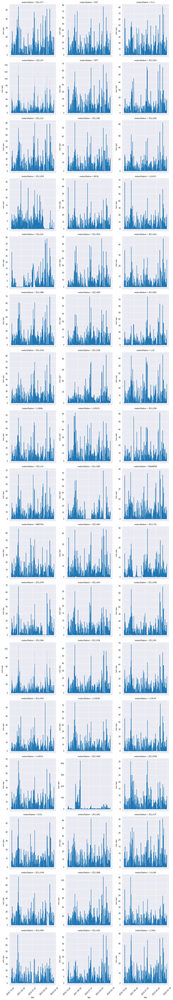

In [15]:
# FacetGrid erstellen
g = sns.FacetGrid(df_rain, col='meteoStation', col_wrap=3, height=4, sharex=True, sharey=False)
g.map(sns.lineplot, 'time', 'rainSumDay')

# Achsenbeschriftungen und Titel hinzufügen
for ax in g.axes.flat:
    ax.set_xlabel('day')
    ax.set_ylabel('mm rain')

    # Intervall der x-Achsenbeschriftungen anpassen
    ax.xaxis.set_major_locator(plt.MaxNLocator(5))

    # Rotation der Beschriftungen
    for label in ax.get_xticklabels():
        label.set_rotation(45)

plt.show()

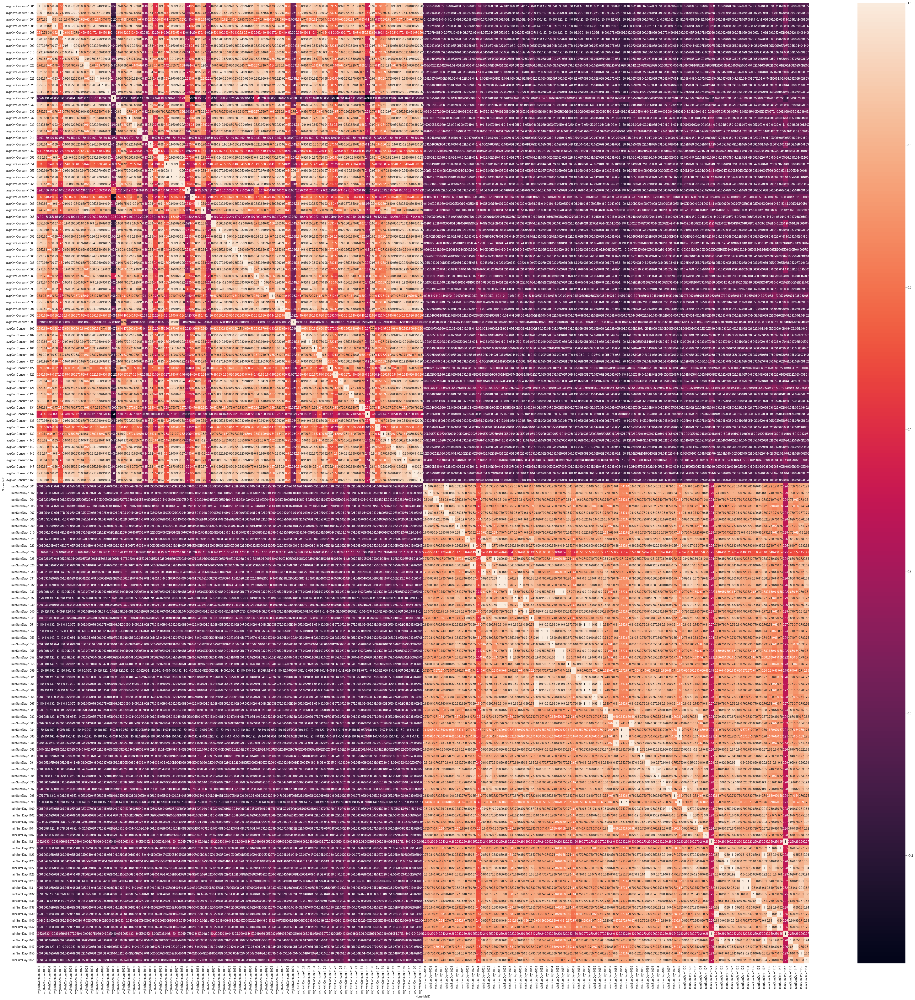

In [16]:
fig = plt.figure(figsize=(60, 60))
sns.heatmap(df_rainPowerPivot.corr(), annot=True)
plt.show()

Das kopieren der Werte wird solange fortgesetzt, bis keine na Werte mehr vorhanden sind. Am Ende wird ein Zähler ausgegeben, wie viele Iterationen vorgenommen wurden. 

In [17]:
columns = df_rainPowerPivot['rainSumDay'].columns.tolist()
counter = 1
cycle = 0

while df_rainPowerPivot.isna().rainSumDay.any().sum() != 0:
    cycle += 1
    for column in columns:
        df_rainPowerPivot[('rainSumDay', column)].fillna(df_rainPowerPivot[('rainSumDay', columns[counter])], inplace=True)
        if counter == len(columns)-1:
            counter = 0
        else:
            counter += 1
print("Anzahl durchgeführter Zyklen zum kopieren:\t", cycle)
df_rainPowerPivot.info()
df_rainPowerPivot.head()


/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/856253774.py:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_rainPowerPivot[('rainSumDay', column)].fillna(df_rainPowerPivot[('rainSumDay', columns[counter])], inplace=True)
/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/856253774.py:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work be

Anzahl durchgeführter Zyklen zum kopieren:	 54
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1162 entries, 2020-12-31 to 2024-03-06
Columns: 146 entries, ('avgKwhConsum', 1001) to ('rainSumDay', 1151)
dtypes: float64(146)
memory usage: 1.3 MB


/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/856253774.py:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_rainPowerPivot[('rainSumDay', column)].fillna(df_rainPowerPivot[('rainSumDay', columns[counter])], inplace=True)
/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/856253774.py:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work be

avgKwhConsum                                              \
bfsID              1001       1002       1004       1005       1007   
time                                                                  
2020-12-31     1.695778   1.907807   2.436917   2.650554   1.528791   
2021-01-01    21.895927  17.801077  20.220615  23.538709  20.903226   
2021-01-02    22.447296  18.758618  18.284424  23.447896  21.380422   
2021-01-03    22.783563  18.726913  18.565640  24.511893  21.583592   
2021-01-04    23.926130  20.237471  19.457000  25.161400  21.906430   

                                                                   ...  \
bfsID            1008       1009       1010       1021       1023  ...   
time                                                               ...   
2020-12-31   3.065394   1.648554   2.365513   2.121565   2.908474  ...   
2021-01-01  20.479602  18.681705  20.468762  24.785563  31.086677  ...   
2021-01-02  20.677542  19.088684  20.492545  27.005302  33.791567  ...   
2021-01-03  21.111326  19.504651  20.654174  26.860290  35.044798  ...   
2021-01-04  22.268348  19.978183  23.091224  33.972470  38.512041  ...   

           rainSumDay                                               
bfsID            1136 1137 1139 1140 1142 1143 1146 1147 1150 1151  
time                                                                
2020-12-31        0.9  1.0  1.2  1.4  1.2  0.6  1.0  2.0  1.7  0.9  
2021-01-01        8.2  6.8  3.6  7.7  3.6  5.8  6.8  9.0  5.0  5.0  
2021-01-02        0.2  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.1  0.0  
2021-01-03        1.2  0.5  0.3  0.6  0.3  1.3  0.5  1.4  0.3  1.1  
2021-01-04        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  

[5 rows x 146 columns]

Nun werden die Stromdaten mit einer linearen Interpolation ergänzt. Die Kontrolle ergibt, dass die Zeitreihe von 1129 nicht aufgefüllt wird. Dies liegt wohl daran, dass ein Anfangswert fehlt. Aus diesem Grund werden die restlichen Werte mit einem Durchschnittswert der entsprechenden Spalte aufgefüllt.

In [18]:
df_rainPowerPivot.avgKwhConsum.interpolate(method='linear', inplace=True)
df_powerPivotNa = df_rainPowerPivot[df_rainPowerPivot.isna().any(axis=1)]
df_powerPivotNa.head()

/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/1057417727.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_rainPowerPivot.avgKwhConsum.interpolate(method='linear', inplace=True)
/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/1057417727.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rainPowerPiv

avgKwhConsum                                              \
bfsID              1001       1002       1004       1005       1007   
time                                                                  
2020-12-31     1.695778   1.907807   2.436917   2.650554   1.528791   
2021-01-01    21.895927  17.801077  20.220615  23.538709  20.903226   
2021-01-02    22.447296  18.758618  18.284424  23.447896  21.380422   
2021-01-03    22.783563  18.726913  18.565640  24.511893  21.583592   
2021-01-04    23.926130  20.237471  19.457000  25.161400  21.906430   

                                                                   ...  \
bfsID            1008       1009       1010       1021       1023  ...   
time                                                               ...   
2020-12-31   3.065394   1.648554   2.365513   2.121565   2.908474  ...   
2021-01-01  20.479602  18.681705  20.468762  24.785563  31.086677  ...   
2021-01-02  20.677542  19.088684  20.492545  27.005302  33.791567  ...   
2021-01-03  21.111326  19.504651  20.654174  26.860290  35.044798  ...   
2021-01-04  22.268348  19.978183  23.091224  33.972470  38.512041  ...   

           rainSumDay                                               
bfsID            1136 1137 1139 1140 1142 1143 1146 1147 1150 1151  
time                                                                
2020-12-31        0.9  1.0  1.2  1.4  1.2  0.6  1.0  2.0  1.7  0.9  
2021-01-01        8.2  6.8  3.6  7.7  3.6  5.8  6.8  9.0  5.0  5.0  
2021-01-02        0.2  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.1  0.0  
2021-01-03        1.2  0.5  0.3  0.6  0.3  1.3  0.5  1.4  0.3  1.1  
2021-01-04        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  

[5 rows x 146 columns]

In [19]:
df_rainPowerPivot[('avgKwhConsum', 1129)].fillna(df_rainPowerPivot[('avgKwhConsum', 1129)].mean(), inplace=True)
df_powerPivotNa = df_rainPowerPivot[df_rainPowerPivot.isna().any(axis=1)]
print('Keine fehlende Werte?:\t', df_rainPowerPivot.isna().any().sum() == 0)
df_powerPivotNa.head()

Keine fehlende Werte?:	 True


/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/3380113601.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_rainPowerPivot[('avgKwhConsum', 1129)].fillna(df_rainPowerPivot[('avgKwhConsum', 1129)].mean(), inplace=True)


Empty DataFrame
Columns: [(avgKwhConsum, 1001), (avgKwhConsum, 1002), (avgKwhConsum, 1004), (avgKwhConsum, 1005), (avgKwhConsum, 1007), (avgKwhConsum, 1008), (avgKwhConsum, 1009), (avgKwhConsum, 1010), (avgKwhConsum, 1021), (avgKwhConsum, 1023), (avgKwhConsum, 1024), (avgKwhConsum, 1025), (avgKwhConsum, 1026), (avgKwhConsum, 1030), (avgKwhConsum, 1031), (avgKwhConsum, 1032), (avgKwhConsum, 1033), (avgKwhConsum, 1037), (avgKwhConsum, 1039), (avgKwhConsum, 1040), (avgKwhConsum, 1041), (avgKwhConsum, 1051), (avgKwhConsum, 1052), (avgKwhConsum, 1053), (avgKwhConsum, 1054), (avgKwhConsum, 1055), (avgKwhConsum, 1057), (avgKwhConsum, 1058), (avgKwhConsum, 1059), (avgKwhConsum, 1061), (avgKwhConsum, 1063), (avgKwhConsum, 1064), (avgKwhConsum, 1065), (avgKwhConsum, 1067), (avgKwhConsum, 1081), (avgKwhConsum, 1082), (avgKwhConsum, 1083), (avgKwhConsum, 1084), (avgKwhConsum, 1085), (avgKwhConsum, 1086), (avgKwhConsum, 1088), (avgKwhConsum, 1089), (avgKwhConsum, 1091), (avgKwhConsum, 1093), (avgKwhConsum, 1094), (avgKwhConsum, 1095), (avgKwhConsum, 1097), (avgKwhConsum, 1098), (avgKwhConsum, 1099), (avgKwhConsum, 1100), (avgKwhConsum, 1102), (avgKwhConsum, 1103), (avgKwhConsum, 1104), (avgKwhConsum, 1107), (avgKwhConsum, 1121), (avgKwhConsum, 1122), (avgKwhConsum, 1123), (avgKwhConsum, 1125), (avgKwhConsum, 1127), (avgKwhConsum, 1128), (avgKwhConsum, 1129), (avgKwhConsum, 1131), (avgKwhConsum, 1132), (avgKwhConsum, 1136), (avgKwhConsum, 1137), (avgKwhConsum, 1139), (avgKwhConsum, 1140), (avgKwhConsum, 1142), (avgKwhConsum, 1143), (avgKwhConsum, 1146), (avgKwhConsum, 1147), (avgKwhConsum, 1150), (avgKwhConsum, 1151), (rainSumDay, 1001), (rainSumDay, 1002), (rainSumDay, 1004), (rainSumDay, 1005), (rainSumDay, 1007), (rainSumDay, 1008), (rainSumDay, 1009), (rainSumDay, 1010), (rainSumDay, 1021), (rainSumDay, 1023), (rainSumDay, 1024), (rainSumDay, 1025), (rainSumDay, 1026), (rainSumDay, 1030), (rainSumDay, 1031), (rainSumDay, 1032), (rainSumDay, 1033), (rainSumDay, 1037), (rainSumDay, 1039), (rainSumDay, 1040), (rainSumDay, 1041), (rainSumDay, 1051), (rainSumDay, 1052), (rainSumDay, 1053), (rainSumDay, 1054), (rainSumDay, 1055), (rainSumDay, 1057), ...]
Index: []

[0 rows x 146 columns]

Nachdem die Daten kopiert wurden, wird die Tabelle wieder umgestellt, damit die Grafiken erstellt werden können.

In [20]:
df_rainPowerNew = pd.DataFrame(columns=['time', 'rainSumDay', 'bfsID', 'avgKwhConsum'])
df_rainNew = df_rainPowerPivot['rainSumDay']
df_powerNew = df_rainPowerPivot['avgKwhConsum']
df_rainNew = df_rainNew.unstack().reset_index()
df_rainNew.rename(columns={0:'rainSumDay'}, inplace=True)
df_powerNew = df_powerNew.unstack().reset_index()
df_powerNew.rename(columns={0:'avgKwhConsum'}, inplace=True)

df_rainNew.head()
df_powerNew.head()
df_rainPowerNew = pd.merge(df_rainNew, df_powerNew, on=['bfsID', 'time'])
df_rainPowerNew.head()

,bfsID,time,rainSumDay,avgKwhConsum
0,1001,2020-12-31,0.3,1.695778
1,1001,2021-01-01,3.8,21.895927
2,1001,2021-01-02,0.0,22.447296
3,1001,2021-01-03,0.6,22.783563
4,1001,2021-01-04,0.0,23.926130


In [21]:
df_rainPowerNew.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84826 entries, 0 to 84825
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   bfsID         84826 non-null  int64         
 1   time          84826 non-null  datetime64[ns]
 2   rainSumDay    84826 non-null  float64       
 3   avgKwhConsum  84826 non-null  float64       
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 2.6 MB


Zur Kontrolle werden die Daten erneut in einem Facet Grid dargestellt. Die Daten sehen nun vollständig aus. Bei der BFS-Nummer 1024 gibt es noch einen langen Bereich welcher keine Daten anzeigt aber nicht als NAN gewertet wurden. Da dies nicht weiter verfiziert werden kann, wird dieser Datenstamm so belassen. Dasselbe gilt für die BFS-Nummern 1121 und 1143. Diese Daten sehen so aus, als gäbe es einen aussergewöhnlichen Zeitraum, doch es fehlen Anhaltspunkte diese weiter zu untersuchen. <br>
Mit diesen Datenreihen können nun weitere Untersuchungen angestellt werden.

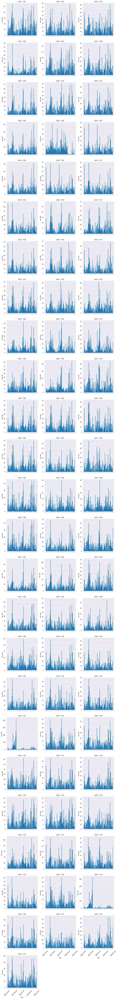

In [22]:
# FacetGrid erstellen
g = sns.FacetGrid(df_rainPowerNew, col='bfsID', col_wrap=3, height=4, sharex=True, sharey=False)
g.map(sns.lineplot, 'time', 'rainSumDay')

# Achsenbeschriftungen und Titel hinzufügen
for ax in g.axes.flat:
    ax.set_xlabel('day')
    ax.set_ylabel('mm rain')

    # Intervall der x-Achsenbeschriftungen anpassen
    ax.xaxis.set_major_locator(plt.MaxNLocator(5))

    # Rotation der Beschriftungen
    for label in ax.get_xticklabels():
        label.set_rotation(45)

plt.show()

### Erstanalyse am Beispiel der Gemeinde Meggen
Wie bei der Analyse mit den Smartmeterdaten und Sonnenminuten wird zunächst mit einem reduzierten Dataset gearbeitet von der Gemeinde Meggen.

In [23]:
df_1063 = df_rainPowerNew.query('bfsID == 1063')
df_1063.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1162 entries, 34860 to 36021
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   bfsID         1162 non-null   int64         
 1   time          1162 non-null   datetime64[ns]
 2   rainSumDay    1162 non-null   float64       
 3   avgKwhConsum  1162 non-null   float64       
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 45.4 KB


Die Zeitreihe wird erneut kontrolliert und scheint vollständig zu sein.

In [24]:
df_1063.drop(columns=['bfsID'], inplace=True)
df_1063.info()
print(pd.date_range(start = '2020-12-31', end='2024-03-06').difference(df_1063['time']))

<class 'pandas.core.frame.DataFrame'>
Index: 1162 entries, 34860 to 36021
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   time          1162 non-null   datetime64[ns]
 1   rainSumDay    1162 non-null   float64       
 2   avgKwhConsum  1162 non-null   float64       
dtypes: datetime64[ns](1), float64(2)
memory usage: 36.3 KB
DatetimeIndex([], dtype='datetime64[ns]', freq='D')


/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/3029096014.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1063.drop(columns=['bfsID'], inplace=True)


Der Stromverbrauch wurde bereits analysiert. Der Niederschlag zeigt ebenfalls eine leichte Saisonalität. In den Bereichen Sommer und Herbst scheint es tendenziell mehr Niederschlag zu geben, während es im Winter nach weniger Niederschlag aussieht. 

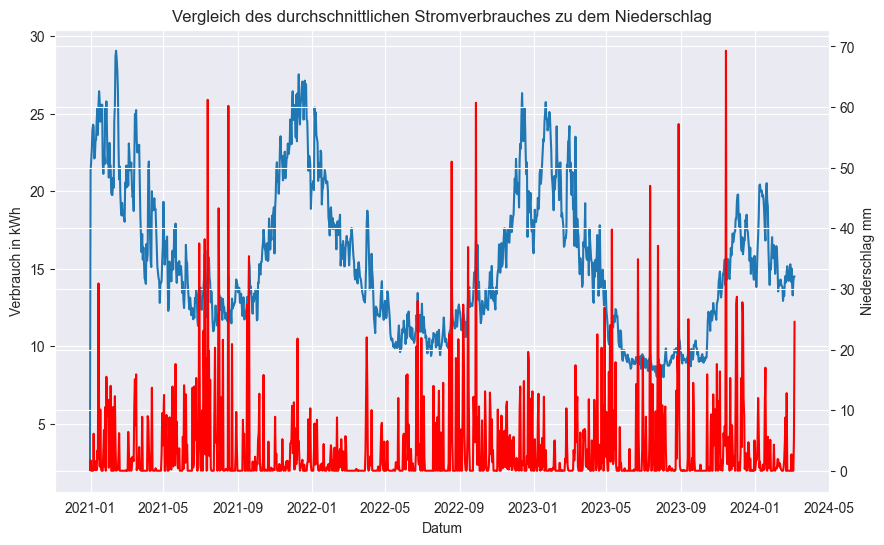

In [25]:
meggenPlot, ax1 = plt.subplots(figsize=(10, 6))
sns.lineplot(x='time', y='avgKwhConsum', data=df_1063, ax=ax1).set(title='Vergleich des durchschnittlichen Stromverbrauches zu dem Niederschlag', xlabel='Datum', ylabel='Verbrauch in kWh')
ax2 = ax1.twinx()
sns.lineplot(data=df_1063, x='time', y='rainSumDay', ax=ax2, color='red').set(ylabel='Niederschlag mm')
plt.xticks(rotation=90)
plt.show()

Als nächstes wird die Korrelation in Meggen betrachtet. Die Zeit-Spalte wird als Index verwendet. Mit einer Korrelation von -0.017 besteht kein Zusammenhang zwischen dem Niederschlag und des Stromverbrauches.<br>
Die Autocorrelation gibt anhand verschiedener Intervall an, wie stark die Werte von vorhergehenden Punkten in derselben Zeitreihe beeinflusst werden. Bei dem Niederschlag gibt es keine Regelmässigkeiten. Die Korrelationen bezüglich dem Strom wurden bereits in der vorhergehenden Analyse mit der Sonne beleuchtet.

In [29]:
df_1063.set_index('time', inplace=True)
print('Korrelation zwischen den Parametern:\n', df_1063.corr())
print('\nAutocorrelation des täglichen Niederschlages und Stromverbrauch:')
autocorrOne = df_1063['rainSumDay'].autocorr(lag=1)
print('Niederschlag 1-Tages-Intervall:\t', autocorrOne)
autocorrOneKwh = df_1063['avgKwhConsum'].autocorr(lag=1)
print('Strom 1-Tages-Intervall:\t', autocorrOneKwh)
autocorr7 = df_1063['rainSumDay'].autocorr(lag=7)
print('Niederschlag 7-Tages-Intervall:\t', autocorr7)
autocorr7Kwh = df_1063['avgKwhConsum'].autocorr(lag=7)
print('Strom 7-Tages-Intervall:\t', autocorr7Kwh)
autocorr30 = df_1063['rainSumDay'].autocorr(lag=30)
print('Niederschlag 30-Tages-Intervall:\t', autocorr30)
autocorr30Kwh = df_1063['avgKwhConsum'].autocorr(lag=30)
print('Strom 30-Tages-Intervall:\t', autocorr30Kwh)

autocorr90 = df_1063['rainSumDay'].autocorr(lag=90)
print('Niederschlag 90-Tages-Intervall:\t', autocorr90)
autocorr90Kwh = df_1063['avgKwhConsum'].autocorr(lag=90)
print('Strom 90-Tages-Intervall:\t', autocorr90Kwh)

autocorr365 = df_1063['rainSumDay'].autocorr(lag=365)
print('Niederschlag 365-Tages-Intervall:\t', autocorr365)
autocorr365Kwh = df_1063['avgKwhConsum'].autocorr(lag=365)
print('Strom 365-Tages-Intervall:\t', autocorr365Kwh)

Korrelation zwischen den Parametern:
               rainSumDay  avgKwhConsum
rainSumDay      1.000000     -0.017427
avgKwhConsum   -0.017427      1.000000

Autocorrelation des täglichen Niederschlages und Stromverbrauch:
Niederschlag 1-Tages-Intervall:	 0.18771798453600116
Strom 1-Tages-Intervall:	 0.9651735461779377
Niederschlag 7-Tages-Intervall:	 0.08816445331779939
Strom 7-Tages-Intervall:	 0.8771515414906323
Niederschlag 30-Tages-Intervall:	 -0.014340105987146134
Strom 30-Tages-Intervall:	 0.7428881571826077
Niederschlag 90-Tages-Intervall:	 0.007272098113118629
Strom 90-Tages-Intervall:	 0.05237510099202785
Niederschlag 365-Tages-Intervall:	 -0.021575453517564003
Strom 365-Tages-Intervall:	 0.7439457255339044


### Ausweitung der Analyse auf alle Gemeinden
Im nächsten Schritt wird die Korrelation-Analyse auf die weiteren Gemeinden ausgeweitet. Hier wird keine Auftrennung in Ost und West benötigt, da die fehlenden Werte aufgefüllt wurden.

In [30]:
df_rainPowerPivot.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1162 entries, 2020-12-31 to 2024-03-06
Columns: 146 entries, ('avgKwhConsum', 1001) to ('rainSumDay', 1151)
dtypes: float64(146)
memory usage: 1.3 MB


Für eine bessere optische Ansicht wird mit den Korrelation-Werten eine Heatmap erstellt. Was sofort auffällt sind die beiden violetten Vierecke die herausstechen. Das sind die Korrelationswerte zwischen dem Niederschlag und des Stromverbrauches pro Gemeinde. Aufgrund der Farb-Skallierung erkennt man den erkannten Trend bei der Meggen-Analyse. Die Korrelationen sind sehr schwach, daher besteht wohl eher kein Zusammenhang zwischen dem Niederschlag und dem Stromverbrauch. Unten rechts sind die Korrelationen zwischen dem Niederschlag zwischen den Gemeinden. Diese Werte sind hoch und deuten somit an, dass sich der Niederschlag im Kanton Luzern ähnlich verhält. Oben links befinden sich die Korrelationen zwischen den Gemeinden und des Stromverbrauchs. Vielfach verhaltet sich der Stromverbrauch ähnlich zu den Gemeinden. Es gibt aber einige Ausreisser. Dies kann mit den aussergewöhnlichen Anomalien Zusammenhängen, welche bei einigen Ortschaften in der ersten Analyse erkannt wurden. Dies ist z.B. bei der Gemeinde Kriens (plz=6010/BFS-Nummer=1059).

Korrelation zwischen den Parametern:
                    avgKwhConsum                                          \
bfsID                      1001      1002      1004      1005      1007   
             bfsID                                                        
avgKwhConsum 1001      1.000000  0.958424  0.761372  0.981651  0.582926   
             1002      0.958424  1.000000  0.828541  0.961643  0.714593   
             1004      0.761372  0.828541  1.000000  0.808248  0.799238   
             1005      0.981651  0.961643  0.808248  1.000000  0.620488   
             1007      0.582926  0.714593  0.799238  0.620488  1.000000   
...                         ...       ...       ...       ...       ...   
rainSumDay   1143      0.052457  0.063745  0.100249  0.035616  0.062569   
             1146     -0.067915 -0.060592 -0.096959 -0.083965 -0.063573   
             1147     -0.073346 -0.068051 -0.106437 -0.084233 -0.083991   
             1150     -0.053319 -0.065813 -0.102550 -0.073151 

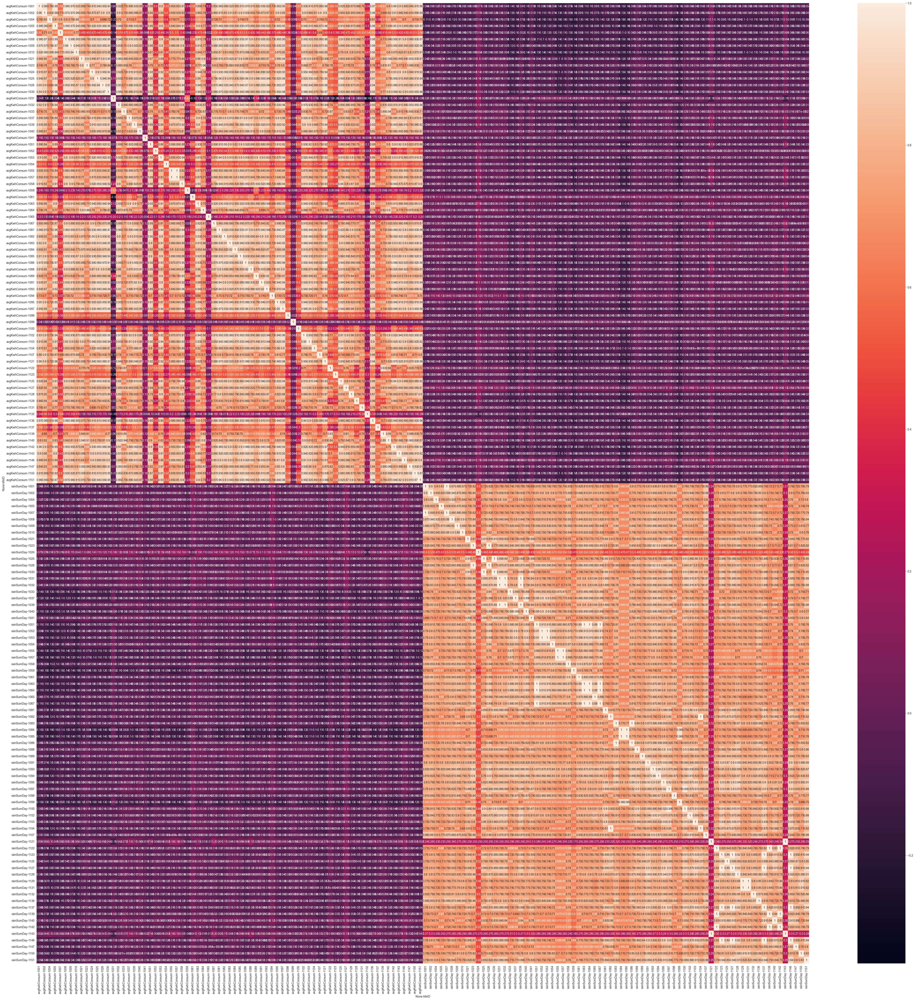

In [31]:
print('Korrelation zwischen den Parametern:\n', df_rainPowerPivot.corr())

fig = plt.figure(figsize=(60, 60))
sns.heatmap(df_rainPowerPivot.corr(), annot=True)
plt.show()

Um die Korrelationen der Zeitreihen noch besser zu verstehen folgt der Test, der Autokorrelation.

In [32]:
columns = list(df_rainPowerPivot)

autocorrOneDay = []

#1 Day Correlation
for column in df_rainPowerPivot:
    autocorrOneSun = df_rainPowerPivot[column].autocorr(lag=1)
    col1 = column[0]+ 'OneDay'
    autocorrOneDay.append([col1,column[1],autocorrOneSun])
    
#7 Day Correlation
for column in df_rainPowerPivot:
    autocorrOneSun = df_rainPowerPivot[column].autocorr(lag=7)
    col7 = column[0]+ '7Day'
    autocorrOneDay.append([col7,column[1],autocorrOneSun])

#30 Day Correlation
for column in df_rainPowerPivot:
    autocorrOneSun = df_rainPowerPivot[column].autocorr(lag=30)
    col30 = column[0]+ '30Day'
    autocorrOneDay.append([col30,column[1],autocorrOneSun])

for column in df_rainPowerPivot:
    autocorrOneSun = df_rainPowerPivot[column].autocorr(lag=90)
    col90 = column[0]+ '90Day'
    autocorrOneDay.append([col90,column[1],autocorrOneSun])

for column in df_rainPowerPivot:
    autocorrOneSun = df_rainPowerPivot[column].autocorr(lag=365)
    col365 = column[0]+ '365Day'
    autocorrOneDay.append([col365,column[1],autocorrOneSun])

df = pd.DataFrame(autocorrOneDay)
df = df.pivot(index=1, columns=0, values=2)
df.head()

,avgKwhConsum30Day,avgKwhConsum365Day,avgKwhConsum7Day,avgKwhConsum90Day,avgKwhConsumOneDay,rainSumDay30Day,rainSumDay365Day,rainSumDay7Day,rainSumDay90Day,rainSumDayOneDay
1,,,,,,,,,,
1001,0.682077,0.787560,0.834297,0.008206,0.958267,-0.006631,-0.044399,0.038874,-0.012994,0.263191
1002,0.616263,0.706079,0.781242,0.051352,0.946376,-0.004376,-0.063795,0.026738,-0.022894,0.247045
1004,0.499709,0.563590,0.747612,-0.022852,0.914220,-0.032297,-0.075515,0.040948,-0.015851,0.293982
1005,0.701692,0.824486,0.852714,0.015429,0.965896,-0.012914,-0.058964,0.058104,0.002084,0.280362
1007,0.216473,0.479355,0.446719,-0.027834,0.912785,-0.006166,-0.044058,0.040662,-0.014802,0.255817


Im Boxplot setzt sich die Erkenntnis von Meggen weiter. Die Korrelationen innerhalb der Intervalle liegen praktisch bei 0 und zeigen somit keinen Zusammenhang. Dies bedeutet z.B., wenn es heute regnet, muss dies nicht zwingend bedeuten, dass es dies in einem Jahr ebenfalls tut. Das Wetter in einem Jahr kann nicht durch das heutige Wetter vorhergesagt werden. Beim Strom kann dies eher behauptet werden.

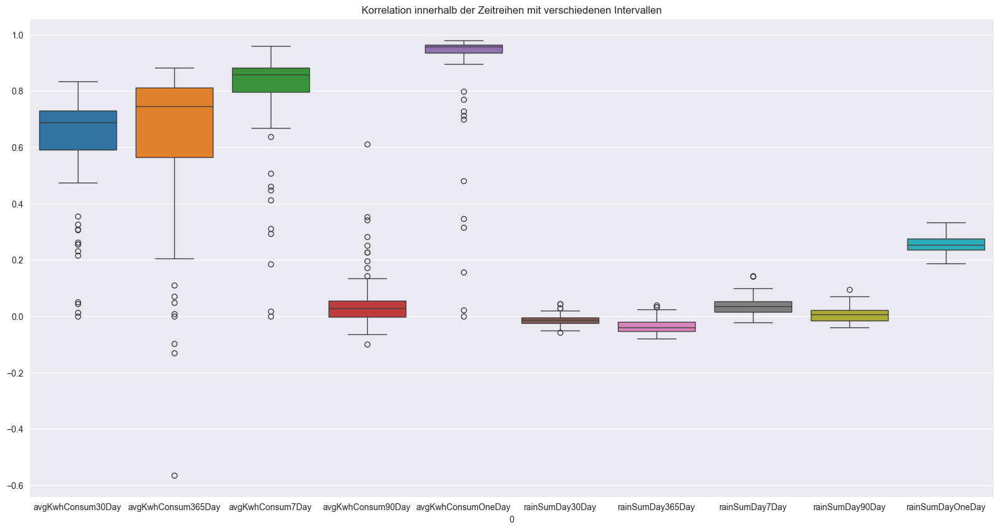

,avgKwhConsum30Day,avgKwhConsum365Day,avgKwhConsum7Day,avgKwhConsum90Day,avgKwhConsumOneDay,rainSumDay30Day,rainSumDay365Day,rainSumDay7Day,rainSumDay90Day,rainSumDayOneDay
count,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000
mean,0.605219,0.609230,0.781563,0.055224,0.879911,-0.011798,-0.034031,0.035513,0.003855,0.251812
std,0.206521,0.294280,0.203191,0.109052,0.213045,0.019464,0.026938,0.032345,0.026765,0.033542
min,-0.001081,-0.564617,-0.000105,-0.099085,0.000223,-0.057809,-0.079558,-0.023170,-0.039852,0.187718
25%,0.590893,0.563590,0.795299,-0.001998,0.935296,-0.023556,-0.052209,0.015419,-0.015851,0.235949
50%,0.688649,0.745199,0.857884,0.028231,0.956489,-0.013819,-0.040172,0.034121,0.005966,0.254286
75%,0.730617,0.810866,0.882945,0.054202,0.965174,-0.005243,-0.021196,0.052385,0.021470,0.275835
max,0.833440,0.881850,0.960128,0.610346,0.980169,0.043285,0.038719,0.143814,0.094920,0.333860


In [33]:
fig = plt.figure(figsize=(20, 10))
sns.boxplot(df).set(title='Korrelation innerhalb der Zeitreihen mit verschiedenen Intervallen')
plt.show()
df.describe()

Für den Boxplot der Korrelationen zwischen den Parametern werden normale Korrelationsmatrixen erstellt und die nicht notwendigen Index und Spalten entfernt.

In [36]:
df_corrRain = df_rainPowerPivot[['avgKwhConsum', 'rainSumDay']].corr()
df_corrRain.drop(columns=['rainSumDay'], index=['avgKwhConsum'],inplace=True)

Der Boxplot das 75% der Korrelationswerte zwischen ca. 0.08 und -0.15 sind, also keine Korrelation aufweisen. Die restlichen 25% verteilen sich als Outlier oben und unten, wobei der Höchstwert bei ca. 0.2 liegt und der tiefste Wert bei -0.2.

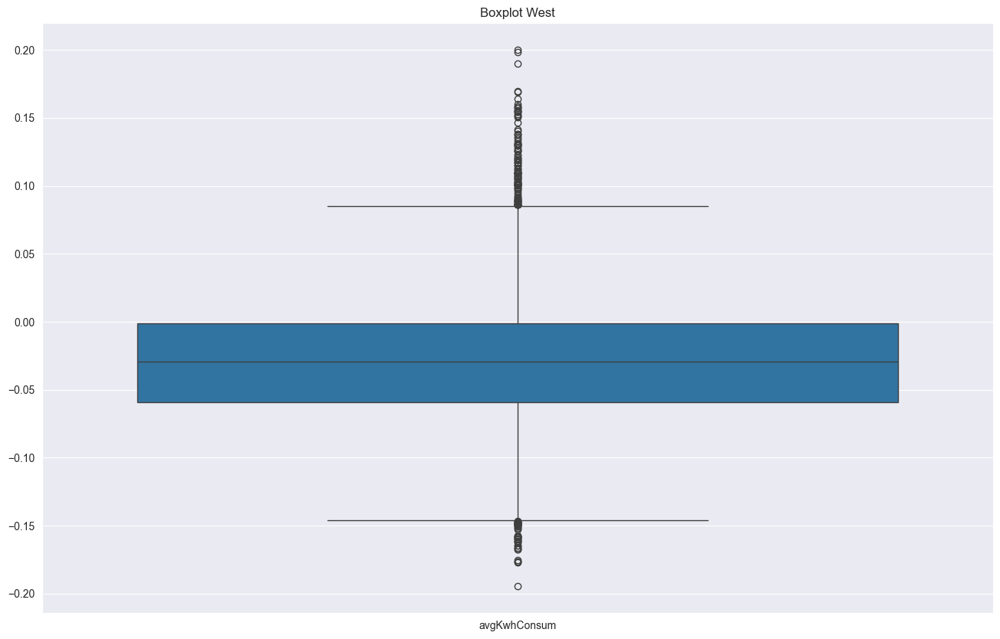

avgKwhConsum                                                         \
bfsID         1001       1002       1004       1005       1007       1008   
count    73.000000  73.000000  73.000000  73.000000  73.000000  73.000000   
mean     -0.069508  -0.066557  -0.103553  -0.085832  -0.076168  -0.069459   
std       0.042326   0.042508   0.047574   0.043624   0.034090   0.044020   
min      -0.147792  -0.145143  -0.194676  -0.164915  -0.150439  -0.148899   
25%      -0.093238  -0.084816  -0.125197  -0.104777  -0.095509  -0.087919   
50%      -0.067915  -0.067489  -0.105498  -0.085157  -0.080522  -0.069187   
75%      -0.052580  -0.049416  -0.093958  -0.070252  -0.062906  -0.054469   
max       0.071270   0.075766   0.102636   0.072632   0.062569   0.086941   

                                                   ...                        \
bfsID       1009       1010       1021       1023  ...       1136       1137   
count  73.000000  73.000000  73.000000  73.000000  ...  73.000000  73.000000   
mean   -0.056057  -0.096373  -0.039198  -0.016091  ...  -0.054703  -0.034103   
std     0.043909   0.045368   0.037739   0.034938  ...   0.043998   0.034352   
min    -0.141996  -0.177052  -0.121280  -0.094984  ...  -0.140398  -0.123643   
25%    -0.072856  -0.116737  -0.060308  -0.039575  ...  -0.074347  -0.052891   
50%    -0.055320  -0.101506  -0.037299  -0.014283  ...  -0.054099  -0.028696   
75%    -0.040367  -0.083155  -0.022267   0.002250  ...  -0.035967  -0.011925   
max     0.109738   0.068783   0.100131   0.080414  ...   0.089468   0.071437   

                                                                         \
bfsID       1139       1140       1142       1143       1146       1147   
count  73.000000  73.000000  73.000000  73.000000  73.000000  73.000000   
mean    0.003662  -0.031729  -0.065344  -0.041180   0.036166  -0.014199   
std     0.035673   0.036479   0.042671   0.041612   0.045021   0.040898   
min    -0.078170  -0.110711  -0.159491  -0.133896  -0.090096  -0.098082   
25%    -0.020207  -0.050936  -0.086989  -0.067321   0.014258  -0.038963   
50%     0.003699  -0.031806  -0.065199  -0.042546   0.037872  -0.017741   
75%     0.023117  -0.017602  -0.045921  -0.022095   0.059741   0.003313   
max     0.090324   0.076255   0.094588   0.084570   0.154384   0.107148   

                             
bfsID       1150       1151  
count  73.000000  73.000000  
mean   -0.045250  -0.053572  
std     0.041120   0.041153  
min    -0.124108  -0.136661  
25%    -0.067563  -0.073053  
50%    -0.049780  -0.054451  
75%    -0.032635  -0.036040  
max     0.098753   0.086101  

[8 rows x 73 columns]

In [42]:
fig = plt.figure(figsize=(16,10))
sns.boxplot(data=df_corrRain).set(title='Boxplot über die Korrelationen zwischen dem Niederschlag und Stromverbrauch')
plt.show()
df_corrRain.describe()

Abschliessend kann festgehalten werden, dass der Niederschlag an sich keine Auswirkung auf den Stromverbrauch hat.

## Datenanalyse Smartmeter mit der Temperatur
Zuerst werden die Daten aus der Datenbank geladen und gleich im korrekten Zeitformat gesichert. Aus der Analyse ist bekannt, dass gewisse Stationen fehlende Daten ausweisen. Aus bestätigt sich erneut mit den fehlenden Temperatur Daten. Für die Analyse werden werden die durchschnittlichen Temperaturwerte pro Tag und BFS-Nummer verwendet.

In [46]:
df_temp = pd.read_sql_query("SELECT * FROM avgTempPerDayBfsId", connection)
df_temp[['dataTime', 'hour']] = df_temp['dataTime'].str.split(' ', expand=True)
df_temp['dataTime'] = pd.to_datetime(df_temp['dataTime'], format='%Y-%m-%d')
df_temp.drop(columns=['hour'], inplace=True)
df_temp.rename(columns={'dataTime':'time'}, inplace=True)
print(df_temp.count())
df_temp.head()

avgTempDay        92715
time              93040
meteoParameter    93040
bfsID             93040
meteoStation      93040
dtype: int64


,avgTempDay,time,meteoParameter,bfsID,meteoStation
0,-1.416667,2020-12-30,tre200h0,1001,SPF
1,-2.195833,2020-12-31,tre200h0,1001,SPF
2,-0.675000,2021-01-01,tre200h0,1001,SPF
3,-0.850000,2021-01-02,tre200h0,1001,SPF
4,-2.041667,2021-01-03,tre200h0,1001,SPF


Um eine eine erste Übersicht zu erhalten, werden die Daten in einer Grafik dargestellt. Man erkennt sogleich die naheliegende starke Saisonalität. Im Winter ist es kälter und im Sommer wärmer.

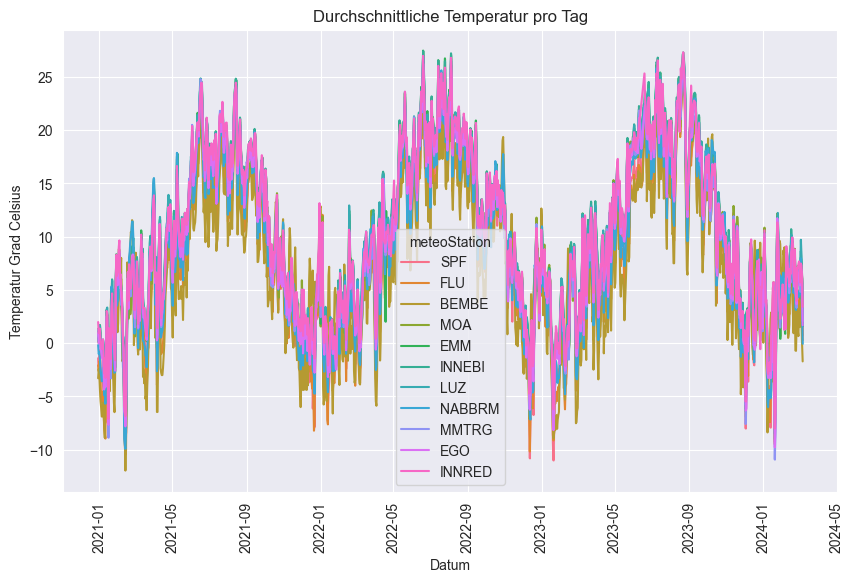

In [47]:
plt.figure(figsize=(10, 6))
testPlot = sns.lineplot(x='time', y='avgTempDay', hue='meteoStation', data=df_temp).set(title='Durchschnittliche Temperatur pro Tag', xlabel='Datum', ylabel='Temperatur Grad Celsius')
plt.xticks(rotation=90)
plt.show()

Um festzustellen, wo sich die fehlenden Daten befinden, wird eine Pivot Tabelle erstellt. Die fehlenden Werte sind mehrfach verteilt und müssen zu einem späteren Zeitpunkt einer Interpollation oder einer anderen Methode aufgefüllt werden.

In [48]:
df_tempPivot = df_temp.pivot(index='time', columns=['bfsID'], values=['avgTempDay'])
df_rainPivot.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1163 entries, 2020-12-30 to 2024-03-06
Data columns (total 80 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   (rainSumDay, 1001)  1101 non-null   float64
 1   (rainSumDay, 1002)  1163 non-null   float64
 2   (rainSumDay, 1004)  1163 non-null   float64
 3   (rainSumDay, 1005)  1117 non-null   float64
 4   (rainSumDay, 1007)  1101 non-null   float64
 5   (rainSumDay, 1008)  1163 non-null   float64
 6   (rainSumDay, 1009)  1139 non-null   float64
 7   (rainSumDay, 1010)  1159 non-null   float64
 8   (rainSumDay, 1021)  1147 non-null   float64
 9   (rainSumDay, 1023)  1155 non-null   float64
 10  (rainSumDay, 1024)  1160 non-null   float64
 11  (rainSumDay, 1025)  1163 non-null   float64
 12  (rainSumDay, 1026)  1155 non-null   float64
 13  (rainSumDay, 1030)  1163 non-null   float64
 14  (rainSumDay, 1031)  1163 non-null   float64
 15  (rainSumDay, 1032)  1163 non-null   f

Für den Stromverbrauch, werden die täglich aufsummierten kWh pro BFS-Nummer geladen. Die Tabelle wird pivotiert um die NAN-Werte zu identifizieren. Da es sich um dieselben Stromverbrauch-Daten handelt, wie in den vorhergehenden Analysen, werden diese zu einem späteren Zeitpunkt gleich behandelt bezüglich den NAN-Werten.

In [49]:
df_power = pd.read_sql_query("SELECT * FROM dailySumSmartmeterBfsId", connection)
df_power['time'] = pd.to_datetime(df_power['time'])

In [50]:
df_powerPivot = df_power.pivot(index='time', columns=['bfsID'], values=['avgKwhConsum'])
df_powerPivot.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1162 entries, 2020-12-31 to 2024-03-06
Data columns (total 73 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   (avgKwhConsum, 1001)  1161 non-null   float64
 1   (avgKwhConsum, 1002)  1161 non-null   float64
 2   (avgKwhConsum, 1004)  1162 non-null   float64
 3   (avgKwhConsum, 1005)  1161 non-null   float64
 4   (avgKwhConsum, 1007)  1161 non-null   float64
 5   (avgKwhConsum, 1008)  1161 non-null   float64
 6   (avgKwhConsum, 1009)  1161 non-null   float64
 7   (avgKwhConsum, 1010)  1162 non-null   float64
 8   (avgKwhConsum, 1021)  1161 non-null   float64
 9   (avgKwhConsum, 1023)  1161 non-null   float64
 10  (avgKwhConsum, 1024)  1162 non-null   float64
 11  (avgKwhConsum, 1025)  1161 non-null   float64
 12  (avgKwhConsum, 1026)  1161 non-null   float64
 13  (avgKwhConsum, 1030)  1161 non-null   float64
 14  (avgKwhConsum, 1031)  1161 non-null   float64
 15  (av

Für die spätere Behandlung der NAN-Werte wird eine kombinierte Pivot Tabelle mit den Stromverbrauchs- und Temperatur-Daten gebildet.

In [51]:
df_tempPower = pd.merge(df_temp, df_power,on=['bfsID', 'time'])
df_tempPower['time'] = pd.to_datetime(df_tempPower['time'])
df_tempPower.head()

,avgTempDay,time,meteoParameter,bfsID,meteoStation,avgKwhConsum,lawCityName
0,-2.195833,2020-12-31,tre200h0,1001,SPF,1.695778,Doppleschwand
1,-0.675000,2021-01-01,tre200h0,1001,SPF,21.895927,Doppleschwand
2,-0.850000,2021-01-02,tre200h0,1001,SPF,22.447296,Doppleschwand
3,-2.041667,2021-01-03,tre200h0,1001,SPF,22.783563,Doppleschwand
4,-3.583333,2021-01-04,tre200h0,1001,SPF,23.926130,Doppleschwand


In [52]:
df_tempPower.drop(columns=['meteoParameter', 'lawCityName', 'meteoStation'], inplace=True)
df_tempPowerPivot = df_tempPower.pivot(index='time', columns=['bfsID'], values=['avgKwhConsum', 'avgTempDay'])
df_rainPowerPivot.head()
df_rainPowerPivot.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1162 entries, 2020-12-31 to 2024-03-06
Columns: 146 entries, ('avgKwhConsum', 1001) to ('rainSumDay', 1151)
dtypes: float64(146)
memory usage: 1.3 MB


Anhand der Grafiken, lassen sich nicht lange Zeiträume feststellen, wo es fehlende Daten gibt. Aus diesem Grund wird eine lineare Interpolation angewendet. Als Alternative hätten die fehlende Zeiträume mit Daten von anderen Messstationen zum gleichen Zeitpunkt kopiert werden können. Dieser Ansatz basiert auf der Idee, dass durch die relativ nahen geografischen Standorten, die Unterschiede nicht signifikant sein werden. Diese Annahme wird auch gestützt aufgrund der Korrelationsmatrix. Aus optischer Perspektive bewegen sich die Korrelationen um den Wert von 0.9.

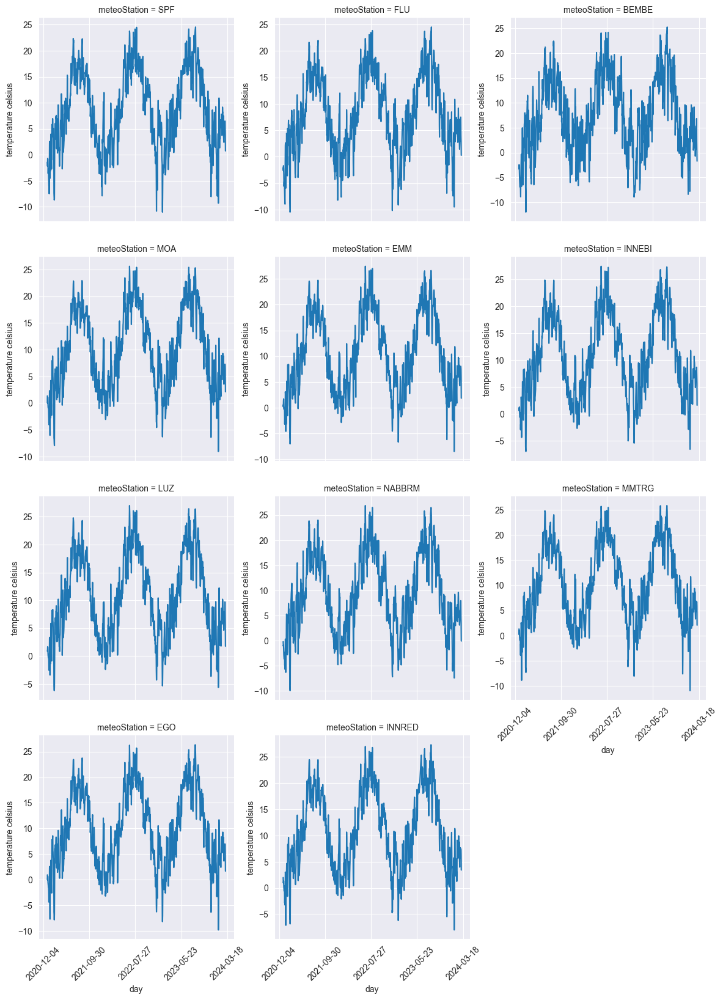

In [53]:
# FacetGrid erstellen
g = sns.FacetGrid(df_temp, col='meteoStation', col_wrap=3, height=4, sharex=True, sharey=False)
g.map(sns.lineplot, 'time', 'avgTempDay')

# Achsenbeschriftungen und Titel hinzufügen
for ax in g.axes.flat:
    ax.set_xlabel('day')
    ax.set_ylabel('temperature celsius')

    # Intervall der x-Achsenbeschriftungen anpassen
    ax.xaxis.set_major_locator(plt.MaxNLocator(5))

    # Rotation der Beschriftungen
    for label in ax.get_xticklabels():
        label.set_rotation(45)

plt.show()

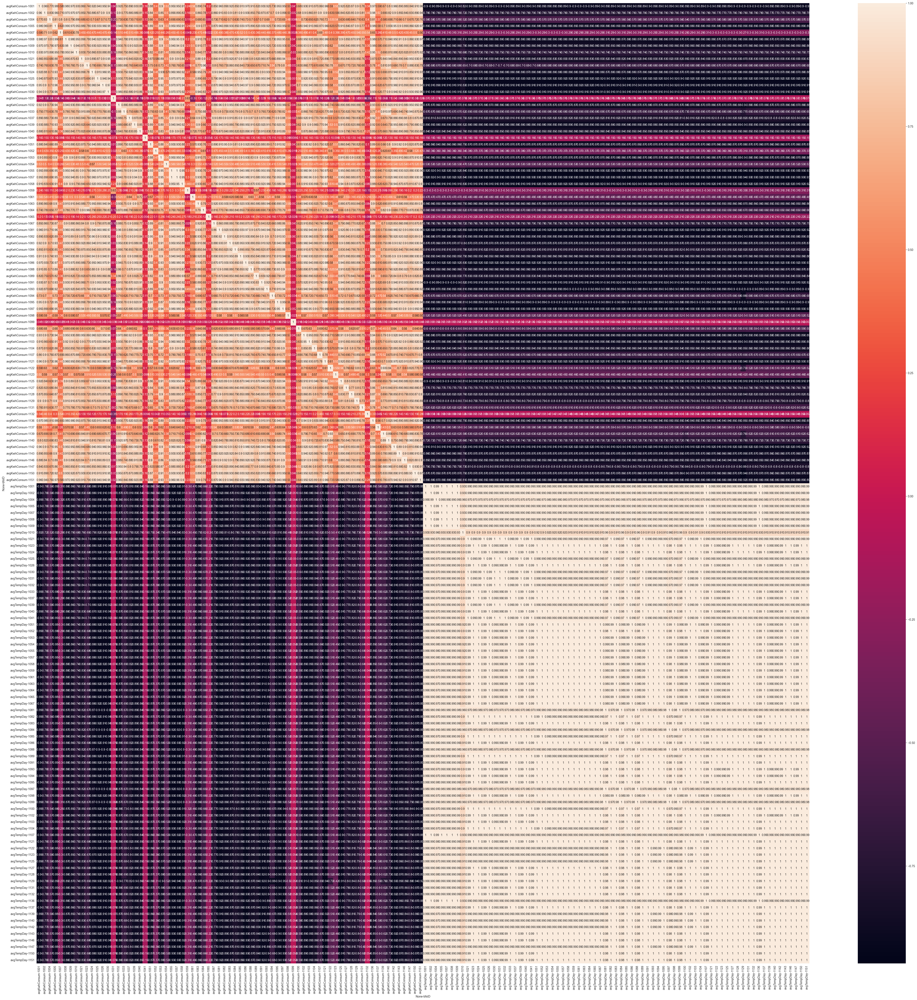

In [54]:
fig = plt.figure(figsize=(60, 60))
sns.heatmap(df_tempPowerPivot.corr(), annot=True)
plt.show()

Zuerst wird die Interpolation der Temperaturen vorgenommen.

In [57]:
df_tempPowerPivot.avgTempDay.interpolate(method='linear', inplace=True)

/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/1162702477.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_tempPowerPivot.avgTempDay.interpolate(method='linear', inplace=True)
/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/1162702477.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_tempPowerPivot

avgKwhConsum                                              \
bfsID              1001       1002       1004       1005       1007   
time                                                                  
2020-12-31     1.695778   1.907807   2.436917   2.650554   1.528791   
2021-01-01    21.895927  17.801077  20.220615  23.538709  20.903226   
2021-01-02    22.447296  18.758618  18.284424  23.447896  21.380422   
2021-01-03    22.783563  18.726913  18.565640  24.511893  21.583592   
2021-01-04    23.926130  20.237471  19.457000  25.161400  21.906430   

                                                                   ...  \
bfsID            1008       1009       1010       1021       1023  ...   
time                                                               ...   
2020-12-31   3.065394   1.648554   2.365513   2.121565   2.908474  ...   
2021-01-01  20.479602  18.681705  20.468762  24.785563  31.086677  ...   
2021-01-02  20.677542  19.088684  20.492545  27.005302  33.791567  ...   
2021-01-03  21.111326  19.504651  20.654174  26.860290  35.044798  ...   
2021-01-04  22.268348  19.978183  23.091224  33.972470  38.512041  ...   

           avgTempDay                                                    \
bfsID            1136      1137      1139      1140      1142      1143   
time                                                                      
2020-12-31  -2.195833 -0.025000  0.950000  0.950000  0.950000 -0.025000   
2021-01-01  -0.675000  0.454167  1.154167  1.154167  1.154167  0.454167   
2021-01-02  -0.850000  0.645833  1.358333  1.358333  1.358333  0.645833   
2021-01-03  -2.041667 -0.491667  0.200000  0.200000  0.200000 -0.491667   
2021-01-04  -3.583333 -0.766667 -0.154167 -0.154167 -0.154167 -0.766667   

                                                    
bfsID           1146      1147      1150      1151  
time                                                
2020-12-31 -0.025000  0.950000 -0.025000 -0.025000  
2021-01-01  0.454167  1.154167  0.454167  0.454167  
2021-01-02  0.645833  1.358333  0.645833  0.645833  
2021-01-03 -0.491667  0.200000 -0.491667 -0.491667  
2021-01-04 -0.766667 -0.154167 -0.766667 -0.766667  

[5 rows x 146 columns]

Nun folgen die Interpolationen der Stromverbrauchsdaten nach dem bereits bekannten Muster.

In [58]:
df_tempPowerPivot.avgKwhConsum.interpolate(method='linear', inplace=True)
df_tempPivotNa = df_tempPowerPivot[df_tempPowerPivot.isna().any(axis=1)]
df_tempPivotNa.head()

/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/4153360800.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_tempPowerPivot.avgKwhConsum.interpolate(method='linear', inplace=True)
/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/4153360800.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_tempPowerPiv

avgKwhConsum                                              \
bfsID              1001       1002       1004       1005       1007   
time                                                                  
2020-12-31     1.695778   1.907807   2.436917   2.650554   1.528791   
2021-01-01    21.895927  17.801077  20.220615  23.538709  20.903226   
2021-01-02    22.447296  18.758618  18.284424  23.447896  21.380422   
2021-01-03    22.783563  18.726913  18.565640  24.511893  21.583592   
2021-01-04    23.926130  20.237471  19.457000  25.161400  21.906430   

                                                                   ...  \
bfsID            1008       1009       1010       1021       1023  ...   
time                                                               ...   
2020-12-31   3.065394   1.648554   2.365513   2.121565   2.908474  ...   
2021-01-01  20.479602  18.681705  20.468762  24.785563  31.086677  ...   
2021-01-02  20.677542  19.088684  20.492545  27.005302  33.791567  ...   
2021-01-03  21.111326  19.504651  20.654174  26.860290  35.044798  ...   
2021-01-04  22.268348  19.978183  23.091224  33.972470  38.512041  ...   

           avgTempDay                                                    \
bfsID            1136      1137      1139      1140      1142      1143   
time                                                                      
2020-12-31  -2.195833 -0.025000  0.950000  0.950000  0.950000 -0.025000   
2021-01-01  -0.675000  0.454167  1.154167  1.154167  1.154167  0.454167   
2021-01-02  -0.850000  0.645833  1.358333  1.358333  1.358333  0.645833   
2021-01-03  -2.041667 -0.491667  0.200000  0.200000  0.200000 -0.491667   
2021-01-04  -3.583333 -0.766667 -0.154167 -0.154167 -0.154167 -0.766667   

                                                    
bfsID           1146      1147      1150      1151  
time                                                
2020-12-31 -0.025000  0.950000 -0.025000 -0.025000  
2021-01-01  0.454167  1.154167  0.454167  0.454167  
2021-01-02  0.645833  1.358333  0.645833  0.645833  
2021-01-03 -0.491667  0.200000 -0.491667 -0.491667  
2021-01-04 -0.766667 -0.154167 -0.766667 -0.766667  

[5 rows x 146 columns]

In [60]:
df_tempPowerPivot[('avgKwhConsum', 1129)].fillna(df_tempPowerPivot[('avgKwhConsum', 1129)].mean(), inplace=True)
df_powerPivotNa = df_tempPowerPivot[df_tempPowerPivot.isna().any(axis=1)]
print('Keine fehlende Werte?:\t', df_tempPowerPivot.isna().any().sum() == 0)
df_tempPivotNa.head(1000)

Keine fehlende Werte?:	 False


/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/2904903589.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_tempPowerPivot[('avgKwhConsum', 1129)].fillna(df_tempPowerPivot[('avgKwhConsum', 1129)].mean(), inplace=True)


avgKwhConsum                                              \
bfsID              1001       1002       1004       1005       1007   
time                                                                  
2020-12-31     1.695778   1.907807   2.436917   2.650554   1.528791   
2021-01-01    21.895927  17.801077  20.220615  23.538709  20.903226   
2021-01-02    22.447296  18.758618  18.284424  23.447896  21.380422   
2021-01-03    22.783563  18.726913  18.565640  24.511893  21.583592   
2021-01-04    23.926130  20.237471  19.457000  25.161400  21.906430   
2021-01-05    23.672693  20.290916  19.958800  24.183642  20.995257   
2021-01-06    23.268938  19.936138  20.953038  24.694349  21.546539   
2021-01-07    22.852722  19.509729  21.056816  24.218027  20.807299   
2021-01-08    22.965546  19.634889  21.358532  24.519106  21.562260   
2021-01-09    23.921626  20.316719  22.938585  25.950887  24.481243   
2021-01-10    23.644760  20.216942  21.892777  25.998158  23.802475   
2021-01-11    24.533304  20.759586  21.007731  25.999909  23.510057   
2021-01-12    23.862625  20.485355  19.689001  25.465483  22.215063   
2021-01-13    21.560123  18.730123  17.598254  22.845455  20.771599   
2021-01-14    21.693102  19.208218  18.014669  23.165914  20.425819   
2021-01-15    22.625826  19.924153  17.449688  24.276050  22.933815   
2021-01-16    23.735366  20.690167  21.635013  26.386626  23.565364   
2021-01-17    22.154984  19.223525  18.575337  24.439463  22.407718   
2021-01-18    22.163872  19.081975  18.219414  23.294197  22.499756   
2021-01-19    22.449643  19.406770  18.865611  24.576261  20.593269   
2021-01-20    21.643059  19.071020  16.886399  23.928324  20.151083   
2021-01-21    20.416704  18.114164  16.008644  22.288128  18.635757   
2021-01-22    19.635926  17.335217  17.604319  20.969200  18.581622   
2021-01-23    20.723613  18.407892  19.223441  23.488581  20.460774   
2021-01-24    20.154340  17.851900  18.527294  23.263399  20.220487   
2021-01-25    21.673735  19.364715  18.692009  23.847098  20.151158   
2021-01-26    22.145574  19.795488  18.279696  24.929997  21.728694   
2021-01-27    22.675902  19.791066  18.823848  25.061909  21.053057   
2021-01-28    20.072229  18.374112  17.102741  22.607850  19.315589   
2021-01-29    19.505232  17.884529  16.812282  21.778062  18.802072   
2021-01-30    19.447371  17.806464  18.688156  21.486778  19.398315   

                                                                   ...  \
bfsID            1008       1009       1010       1021       1023  ...   
time                                                               ...   
2020-12-31   3.065394   1.648554   2.365513   2.121565   2.908474  ...   
2021-01-01  20.479602  18.681705  20.468762  24.785563  31.086677  ...   
2021-01-02  20.677542  19.088684  20.492545  27.005302  33.791567  ...   
2021-01-03  21.111326  19.504651  20.654174  26.860290  35.044798  ...   
2021-01-04  22.268348  19.978183  23.091224  33.972470  38.512041  ...   
2021-01-05  21.653573  19.690063  21.673009  36.217952  40.225959  ...   
2021-01-06  21.959482  19.764572  21.505904  33.353048  38.269878  ...   
2021-01-07  21.469982  19.097481  21.110987  32.208127  39.237163  ...   
2021-01-08  21.745163  19.401227  21.417663  37.121619  38.704796  ...   
2021-01-09  22.872130  20.106691  23.019819  35.095698  36.604694  ...   
2021-01-10  22.745091  19.907076  22.905404  32.504492  35.053245  ...   
2021-01-11  22.975351  20.332658  23.018450  38.762698  42.083469  ...   
2021-01-12  22.448354  20.598047  21.634176  36.473063  41.371347  ...   
2021-01-13  20.605445  18.607089  19.802458  36.641857  39.903602  ...   
2021-01-14  20.599202  18.800125  19.962449  41.294518  42.237163  ...   
2021-01-15  21.719861  20.200004  21.321591  51.313237  42.513727  ...   
2021-01-16  22.232046  21.404195  22.423321  38.290765  41.096222  ...   
2021-01-17  20.967231  20.230783  21.023631  29.032384  33.611532  ...   
2021-01-18  20.524922  19.011634  21.31592

Die Schlusskontrolle zeigt, dass bei der BFS-Nummer 1129 der Start der Temperatur Zeitreihe fehlen. Aus diesem Grund werden diese Daten von einer anderen Station kopiert und ergänzt.

In [61]:
columns = df_tempPowerPivot['avgTempDay'].columns.tolist()
counter = 1
cycle = 0

while df_tempPowerPivot.isna().avgTempDay.any().sum() != 0:
    cycle += 1
    for column in columns:
        df_tempPowerPivot[('avgTempDay', column)].fillna(df_tempPowerPivot[('avgTempDay', columns[counter])], inplace=True)
        if counter == len(columns)-1:
            counter = 0
        else:
            counter += 1
print("Anzahl durchgeführter Zyklen zum kopieren:\t", cycle)
df_rainPowerPivot.info()
df_rainPowerPivot.head()

Anzahl durchgeführter Zyklen zum kopieren:	 1
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1162 entries, 2020-12-31 to 2024-03-06
Columns: 146 entries, ('avgKwhConsum', 1001) to ('rainSumDay', 1151)
dtypes: float64(146)
memory usage: 1.3 MB


/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/1258967765.py:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_tempPowerPivot[('avgTempDay', column)].fillna(df_tempPowerPivot[('avgTempDay', columns[counter])], inplace=True)


avgKwhConsum                                              \
bfsID              1001       1002       1004       1005       1007   
time                                                                  
2020-12-31     1.695778   1.907807   2.436917   2.650554   1.528791   
2021-01-01    21.895927  17.801077  20.220615  23.538709  20.903226   
2021-01-02    22.447296  18.758618  18.284424  23.447896  21.380422   
2021-01-03    22.783563  18.726913  18.565640  24.511893  21.583592   
2021-01-04    23.926130  20.237471  19.457000  25.161400  21.906430   

                                                                   ...  \
bfsID            1008       1009       1010       1021       1023  ...   
time                                                               ...   
2020-12-31   3.065394   1.648554   2.365513   2.121565   2.908474  ...   
2021-01-01  20.479602  18.681705  20.468762  24.785563  31.086677  ...   
2021-01-02  20.677542  19.088684  20.492545  27.005302  33.791567  ...   
2021-01-03  21.111326  19.504651  20.654174  26.860290  35.044798  ...   
2021-01-04  22.268348  19.978183  23.091224  33.972470  38.512041  ...   

           rainSumDay                                               
bfsID            1136 1137 1139 1140 1142 1143 1146 1147 1150 1151  
time                                                                
2020-12-31        0.9  1.0  1.2  1.4  1.2  0.6  1.0  2.0  1.7  0.9  
2021-01-01        8.2  6.8  3.6  7.7  3.6  5.8  6.8  9.0  5.0  5.0  
2021-01-02        0.2  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.1  0.0  
2021-01-03        1.2  0.5  0.3  0.6  0.3  1.3  0.5  1.4  0.3  1.1  
2021-01-04        0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  

[5 rows x 146 columns]

Ein Kopierzyklus wurde durchgeführt. Die Abschlusskontrolle findet keine weiteren NAN-Werte aus diesem Grund kann nun mit der weiteren Analyse fortgefahren werden.

In [63]:
print('Keine fehlende Werte?:\t', df_tempPowerPivot.isna().any().sum() == 0)


Keine fehlende Werte?:	 True


Die vollständigen Zeitreihen werden wieder entpivotiert für die weitere Verwendung.

In [64]:
df_tempPowerNew = pd.DataFrame(columns=['time', 'avgTempDay', 'bfsID', 'avgKwhConsum'])
df_tempNew = df_tempPowerPivot['avgTempDay']
df_powerNew = df_tempPowerPivot['avgKwhConsum']
df_tempNew = df_tempNew.unstack().reset_index()
df_tempNew.rename(columns={0:'avgTempDay'}, inplace=True)
df_powerNew = df_powerNew.unstack().reset_index()
df_powerNew.rename(columns={0:'avgKwhConsum'}, inplace=True)

df_tempNew.head()
df_tempNew.head()
df_tempPowerNew = pd.merge(df_tempNew, df_powerNew, on=['bfsID', 'time'])
df_tempPowerNew.head()

,bfsID,time,avgTempDay,avgKwhConsum
0,1001,2020-12-31,-2.195833,1.695778
1,1001,2021-01-01,-0.675000,21.895927
2,1001,2021-01-02,-0.850000,22.447296
3,1001,2021-01-03,-2.041667,22.783563
4,1001,2021-01-04,-3.583333,23.926130


Zur Kontrolle werden die Daten erneut in einem Facet Grid dargestellt. Es bestehen noch immer keine Auffälligkeiten. Aus diesem Grund werden die weiteren Analysen mit diesen Zeitreihen durchgeführt.

In [65]:
df_rainPowerNew.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84826 entries, 0 to 84825
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   bfsID         84826 non-null  int64         
 1   time          84826 non-null  datetime64[ns]
 2   rainSumDay    84826 non-null  float64       
 3   avgKwhConsum  84826 non-null  float64       
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 2.6 MB


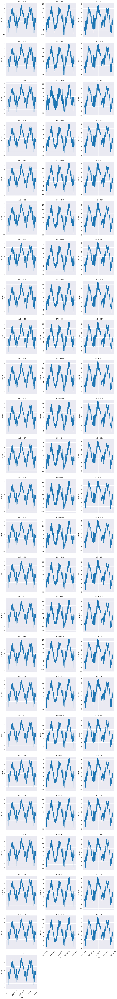

In [67]:
# FacetGrid erstellen
g = sns.FacetGrid(df_tempPowerNew, col='bfsID', col_wrap=3, height=4, sharex=True, sharey=False)
g.map(sns.lineplot, 'time', 'avgTempDay')

# Achsenbeschriftungen und Titel hinzufügen
for ax in g.axes.flat:
    ax.set_xlabel('day')
    ax.set_ylabel('mm rain')

    # Intervall der x-Achsenbeschriftungen anpassen
    ax.xaxis.set_major_locator(plt.MaxNLocator(5))

    # Rotation der Beschriftungen
    for label in ax.get_xticklabels():
        label.set_rotation(45)

plt.show()

### Erstanalyse am Beispiel der Gemeinde Meggen
Wie bei den vorhergehenden Analysen mit den wird zunächst mit einem reduzierten Dataset gearbeitet von der Gemeinde Meggen.

In [68]:
df_1063 = df_tempPowerNew.query('bfsID == 1063')
df_1063.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1162 entries, 34860 to 36021
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   bfsID         1162 non-null   int64         
 1   time          1162 non-null   datetime64[ns]
 2   avgTempDay    1162 non-null   float64       
 3   avgKwhConsum  1162 non-null   float64       
dtypes: datetime64[ns](1), float64(2), int64(1)
memory usage: 45.4 KB


Die Zeitreihe wird erneut kontrolliert und ist vollständig.

In [69]:
df_1063.drop(columns=['bfsID'], inplace=True)
df_1063.info()
print(pd.date_range(start = '2020-12-31', end='2024-03-06').difference(df_1063['time']))

<class 'pandas.core.frame.DataFrame'>
Index: 1162 entries, 34860 to 36021
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   time          1162 non-null   datetime64[ns]
 1   avgTempDay    1162 non-null   float64       
 2   avgKwhConsum  1162 non-null   float64       
dtypes: datetime64[ns](1), float64(2)
memory usage: 36.3 KB
DatetimeIndex([], dtype='datetime64[ns]', freq='D')


/var/folders/q_/22yyqw3s7mq8z87vgh81mmvh0000gn/T/ipykernel_45643/3029096014.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1063.drop(columns=['bfsID'], inplace=True)


Wie der Stromverbrauch, zeigt die Temperatur ebenfalls eine starke Saisonalität. Zudem scheint diese, sehr gegengleich auszuschlagen. Es zeichnet sich eine gute Korrelation ab.

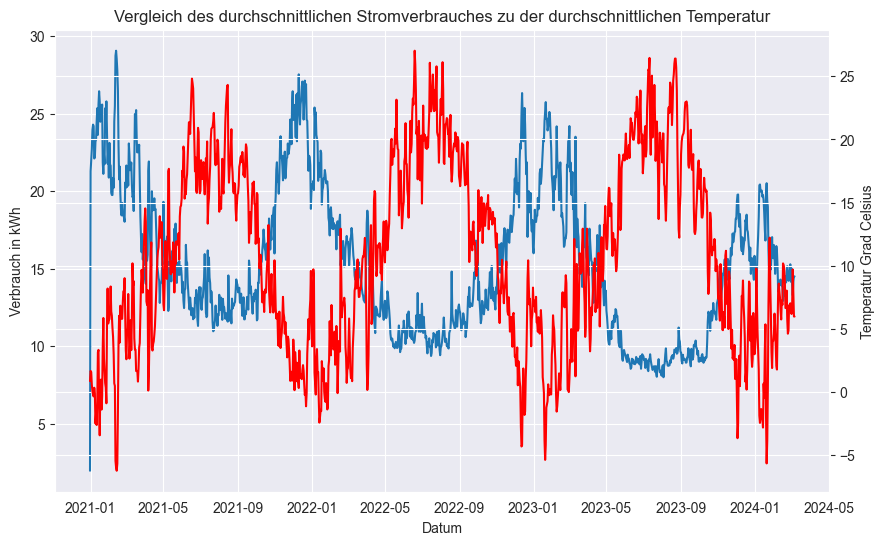

In [70]:
meggenPlot, ax1 = plt.subplots(figsize=(10, 6))
sns.lineplot(x='time', y='avgKwhConsum', data=df_1063, ax=ax1).set(title='Vergleich des durchschnittlichen Stromverbrauches zu der durchschnittlichen Temperatur', xlabel='Datum', ylabel='Verbrauch in kWh')
ax2 = ax1.twinx()
sns.lineplot(data=df_1063, x='time', y='avgTempDay', ax=ax2, color='red').set(ylabel='Temperatur Grad Celsius')
plt.xticks(rotation=90)
plt.show()

Als nächstes wird die Korrelation in Meggen betrachtet. Die Zeit-Spalte wird als Index verwendet. Mit einer Korrelation von -0.87 besteht ein Zusammenhang zwischen der Temperatur und des Stromverbrauches. Durch das negative Vorzeichen, bedeutet dies ein umgekehrter Zusammenhang. Je tiefer die Temperatur, desto höher ist der Stromverbrauch.<br>
Die Autocorrelation gibt anhand verschiedener Intervall an, wie stark die Werte von vorhergehenden Punkten in derselben Zeitreihe beeinflusst werden. Hier gibt es in beiden Fällen eine starke Korrelation auf den entsprechenden Intervallen. Ausgenommen das vierteljährliche Intervall. Die Temperatur ist im Folgejahr in einem ähnlichen Bereich wie heute. 

In [71]:
df_1063.set_index('time', inplace=True)
print('Korrelation zwischen den Parametern:\n', df_1063.corr())
print('\nAutocorrelation der durchschnittlichen Temperatur und Stromverbrauch:')
autocorrOne = df_1063['avgTempDay'].autocorr(lag=1)
print('Temperatur 1-Tages-Intervall:\t', autocorrOne)
autocorrOneKwh = df_1063['avgKwhConsum'].autocorr(lag=1)
print('Strom 1-Tages-Intervall:\t', autocorrOneKwh)
autocorr7 = df_1063['avgTempDay'].autocorr(lag=7)
print('Temperatur 7-Tages-Intervall:\t', autocorr7)
autocorr7Kwh = df_1063['avgKwhConsum'].autocorr(lag=7)
print('Strom 7-Tages-Intervall:\t', autocorr7Kwh)
autocorr30 = df_1063['avgTempDay'].autocorr(lag=30)
print('Temperatur 30-Tages-Intervall:\t', autocorr30)
autocorr30Kwh = df_1063['avgKwhConsum'].autocorr(lag=30)
print('Strom 30-Tages-Intervall:\t', autocorr30Kwh)

autocorr90 = df_1063['avgTempDay'].autocorr(lag=90)
print('Temperatur 90-Tages-Intervall:\t', autocorr90)
autocorr90Kwh = df_1063['avgKwhConsum'].autocorr(lag=90)
print('Strom 90-Tages-Intervall:\t', autocorr90Kwh)

autocorr365 = df_1063['avgTempDay'].autocorr(lag=365)
print('Temperatur 365-Tages-Intervall:\t', autocorr365)
autocorr365Kwh = df_1063['avgKwhConsum'].autocorr(lag=365)
print('Strom 365-Tages-Intervall:\t', autocorr365Kwh)

Korrelation zwischen den Parametern:
               avgTempDay  avgKwhConsum
avgTempDay      1.000000     -0.865679
avgKwhConsum   -0.865679      1.000000

Autocorrelation der durchschnittlichen Temperatur und Stromverbrauch:
Temperatur 1-Tages-Intervall:	 0.9628060464182442
Strom 1-Tages-Intervall:	 0.9651735461779377
Temperatur 7-Tages-Intervall:	 0.8380325715036083
Strom 7-Tages-Intervall:	 0.8771515414906323
Temperatur 30-Tages-Intervall:	 0.7048239801411826
Strom 30-Tages-Intervall:	 0.7428881571826077
Temperatur 90-Tages-Intervall:	 0.0014473854871662208
Strom 90-Tages-Intervall:	 0.05237510099202785
Temperatur 365-Tages-Intervall:	 0.8310722609304029
Strom 365-Tages-Intervall:	 0.7439457255339044


### Ausweitung der Analyse auf alle Gemeinden
Im nächsten Schritt wird die Korrelation-Analyse auf die weiteren Gemeinden ausgeweitet. Hier wird keine Auftrennung in Ost und West benötigt, da die fehlenden Werte aufgefüllt wurden.

In [72]:
df_tempPowerPivot.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1162 entries, 2020-12-31 to 2024-03-06
Columns: 146 entries, ('avgKwhConsum', 1001) to ('avgTempDay', 1151)
dtypes: float64(146)
memory usage: 1.3 MB


Für eine bessere optische Ansicht wird mit den Korrelation-Werten eine Heatmap erstellt. Was sofort auffällt sind die beiden violetten Vierecke die herausstechen. Das sind die Korrelationswerte zwischen der Temperatur und des Stromverbrauches pro Gemeinde. Aufgrund der Farb-Skallierung erkennt man den erkannten Trend bei der Meggen-Analyse. Die Korrelationen sind eher auf der starken negativen Seite, daher besteht wohl Zusammenhang zwischen dem Niederschlag und dem Stromverbrauch. Unten rechts sind die Korrelationen zwischen den Temperaturen zwischen den Gemeinden. Diese Werte sind hoch und deuten somit an, dass sich die Temperaturen im Kanton Luzern sehr ähnlich verhalten. Oben links befinden sich die Korrelationen zwischen den Gemeinden und des Stromverbrauchs. Vielfach verhaltet sich der Stromverbrauch ähnlich zu den Gemeinden. Es gibt aber einige Ausreisser. Dies kann mit den aussergewöhnlichen Anomalien Zusammenhängen, welche bei einigen Ortschaften in der ersten Analyse erkannt wurden. Dies ist z.B. bei der Gemeinde Kriens (plz=6010/BFS-Nummer=1059).

Korrelation zwischen den Parametern:
                    avgKwhConsum                                          \
bfsID                      1001      1002      1004      1005      1007   
             bfsID                                                        
avgKwhConsum 1001      1.000000  0.958424  0.761372  0.981651  0.582926   
             1002      0.958424  1.000000  0.828541  0.961643  0.714593   
             1004      0.761372  0.828541  1.000000  0.808248  0.799238   
             1005      0.981651  0.961643  0.808248  1.000000  0.620488   
             1007      0.582926  0.714593  0.799238  0.620488  1.000000   
...                         ...       ...       ...       ...       ...   
avgTempDay   1143     -0.897819 -0.783511 -0.568053 -0.888867 -0.300420   
             1146     -0.897819 -0.783511 -0.568053 -0.888867 -0.300420   
             1147     -0.890600 -0.774092 -0.552846 -0.881015 -0.287262   
             1150     -0.897819 -0.783511 -0.568053 -0.888867 

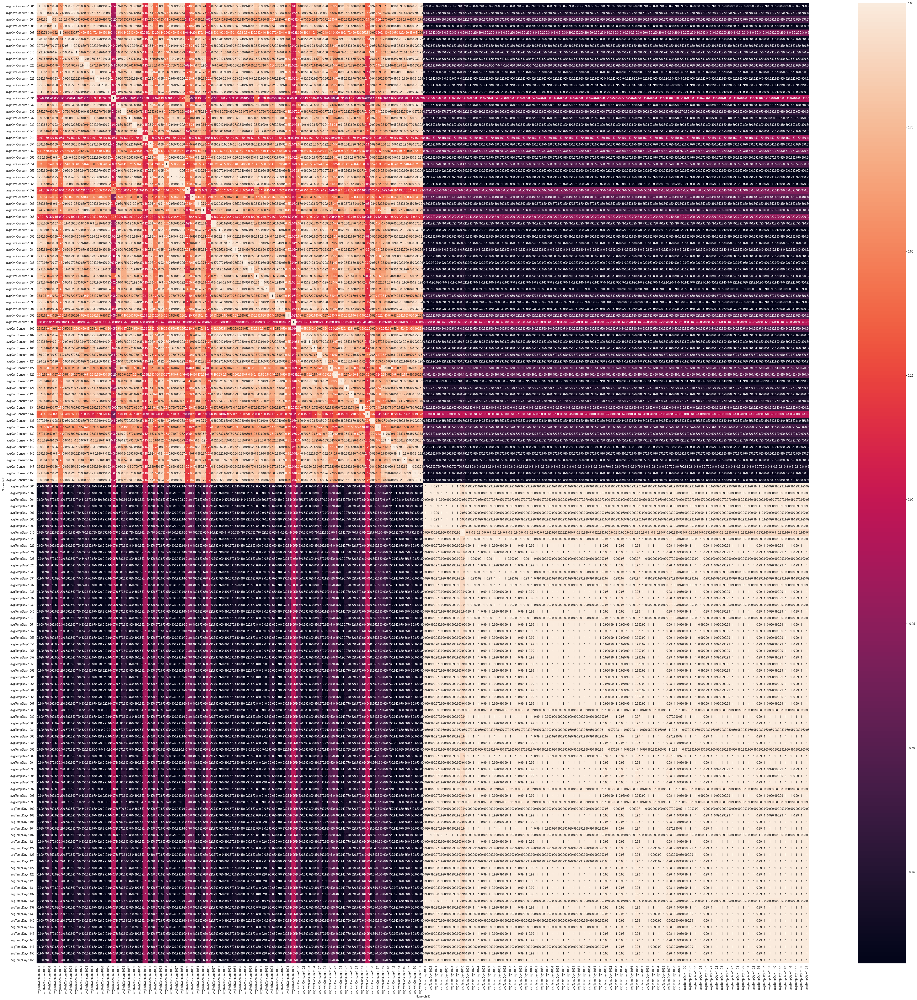

In [74]:
print('Korrelation zwischen den Parametern:\n', df_tempPowerPivot.corr())

fig = plt.figure(figsize=(60, 60))
sns.heatmap(df_tempPowerPivot.corr(), annot=True)
plt.show()

Die Korrelationen werden nun noch weiter betrachtet zunächst in der Autokorrelation.

In [75]:
columns = list(df_tempPowerPivot)

autocorrOneDay = []

#1 Day Correlation
for column in df_tempPowerPivot:
    autocorrOneSun = df_tempPowerPivot[column].autocorr(lag=1)
    col1 = column[0]+ 'OneDay'
    autocorrOneDay.append([col1,column[1],autocorrOneSun])

#7 Day Correlation
for column in df_tempPowerPivot:
    autocorrOneSun = df_tempPowerPivot[column].autocorr(lag=7)
    col7 = column[0]+ '7Day'
    autocorrOneDay.append([col7,column[1],autocorrOneSun])

#30 Day Correlation
for column in df_tempPowerPivot:
    autocorrOneSun = df_tempPowerPivot[column].autocorr(lag=30)
    col30 = column[0]+ '30Day'
    autocorrOneDay.append([col30,column[1],autocorrOneSun])

for column in df_tempPowerPivot:
    autocorrOneSun = df_tempPowerPivot[column].autocorr(lag=90)
    col90 = column[0]+ '90Day'
    autocorrOneDay.append([col90,column[1],autocorrOneSun])

for column in df_tempPowerPivot:
    autocorrOneSun = df_tempPowerPivot[column].autocorr(lag=365)
    col365 = column[0]+ '365Day'
    autocorrOneDay.append([col365,column[1],autocorrOneSun])

df = pd.DataFrame(autocorrOneDay)
df = df.pivot(index=1, columns=0, values=2)
df.head()

,avgKwhConsum30Day,avgKwhConsum365Day,avgKwhConsum7Day,avgKwhConsum90Day,avgKwhConsumOneDay,avgTempDay30Day,avgTempDay365Day,avgTempDay7Day,avgTempDay90Day,avgTempDayOneDay
1,,,,,,,,,,
1001,0.682077,0.787560,0.834297,0.008206,0.958267,0.660757,0.795420,0.803393,-0.005237,0.951913
1002,0.616263,0.706079,0.781242,0.051352,0.946376,0.660757,0.795420,0.803393,-0.005237,0.951913
1004,0.499709,0.563590,0.747612,-0.022852,0.914220,0.618892,0.756533,0.764532,-0.003995,0.942305
1005,0.701692,0.824486,0.852714,0.015429,0.965896,0.660757,0.795420,0.803393,-0.005237,0.951913
1007,0.216473,0.479355,0.446719,-0.027834,0.912785,0.660757,0.795420,0.803393,-0.005237,0.951913


Auf die Boxplots des Stromverbrauchs wird nicht weiter eingegangen. Die Betrachtung der Boxplots über die Temperatur zeigen einen sehr engen Zusammenhang und keine grosse Streuung der Werte. Das 90-Tag-Intervall ist wie dem Stromverbrauch irrelevant.

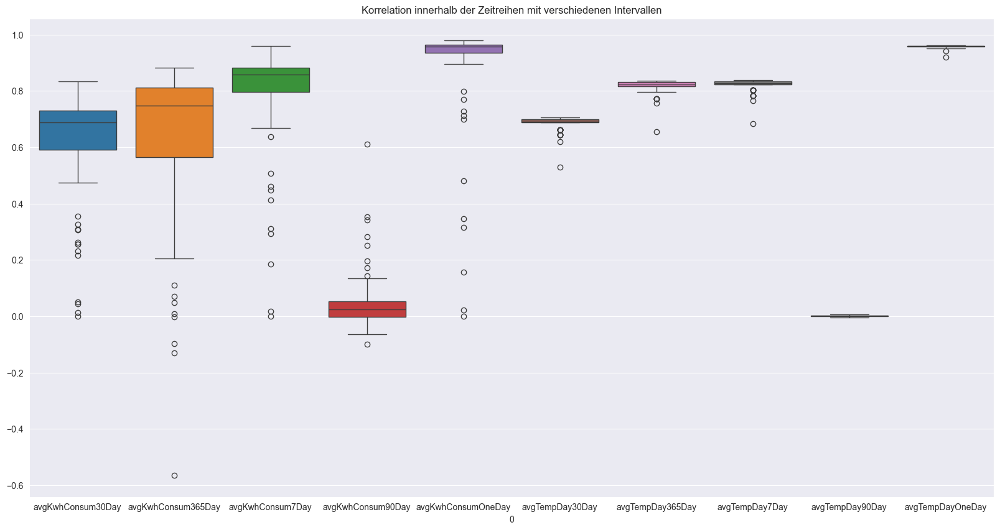

,avgKwhConsum30Day,avgKwhConsum365Day,avgKwhConsum7Day,avgKwhConsum90Day,avgKwhConsumOneDay,avgTempDay30Day,avgTempDay365Day,avgTempDay7Day,avgTempDay90Day,avgTempDayOneDay
count,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000
mean,0.603736,0.615742,0.781113,0.047606,0.879696,0.685519,0.816816,0.822371,0.000595,0.958144
std,0.205450,0.297262,0.202933,0.105614,0.212946,0.026653,0.026983,0.023566,0.003364,0.005821
min,-0.000967,-0.564617,0.000039,-0.099085,0.000373,0.528670,0.654787,0.682774,-0.005237,0.921006
25%,0.590893,0.563590,0.795299,-0.002542,0.935296,0.688479,0.815803,0.823362,-0.001072,0.956483
50%,0.688474,0.747664,0.857884,0.025008,0.956489,0.690481,0.823525,0.827187,0.001092,0.959662
75%,0.730617,0.812716,0.882945,0.052375,0.965174,0.699274,0.831305,0.833751,0.002904,0.960697
max,0.833440,0.881850,0.960128,0.610346,0.980169,0.704824,0.837072,0.838033,0.006666,0.962806


In [76]:
fig = plt.figure(figsize=(20, 10))
sns.boxplot(df).set(title='Korrelation innerhalb der Zeitreihen mit verschiedenen Intervallen')
plt.show()
df.describe()

Für die Boxplots der Korrelationen zwischen den Temperaturen und Stromverbrauch, werden die nicht benötigten Daten entfernt.

In [78]:
df_corrTemp = df_tempPowerPivot[['avgKwhConsum', 'avgTempDay']].corr()
df_corrTemp.drop(columns=['avgTempDay'], index=['avgKwhConsum'],inplace=True)

Mit einem Median bei ca. -0.85 kann von einem starken Zusammenhang ausgegangen werden zwischen der Temperatur und dem Stromverbrauch. Auch bei der Betrachtung des 75% Quantil liegen alle Werte unter ca. -0.65. Dies deutet weiterhin auf einen Zusammenhang hin. Da es wahrscheinlich fehlerbehaftete Smartmeterdaten gibt, könnte die Korrelation noch höher sein.

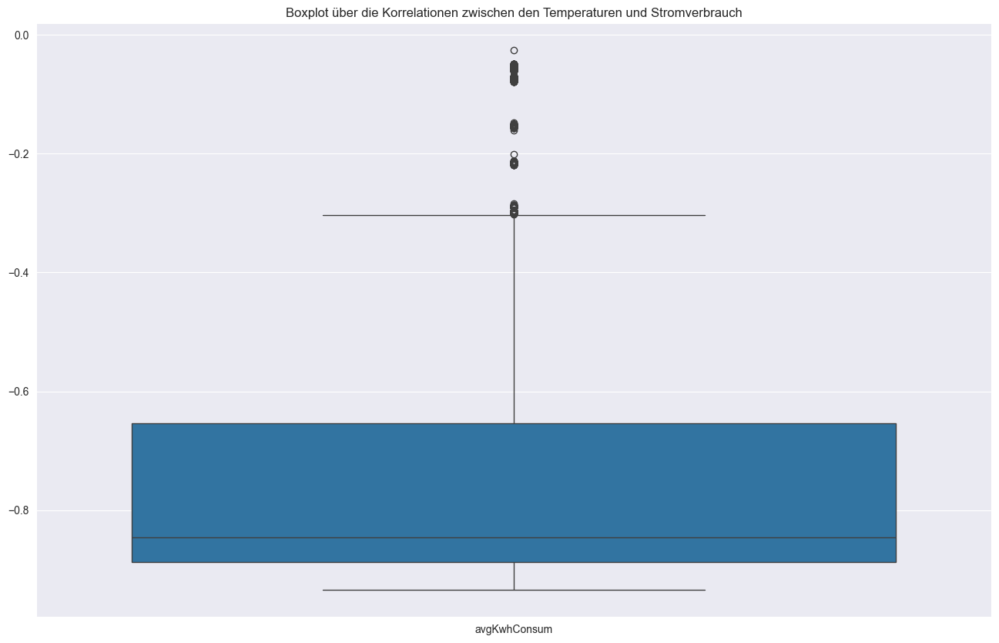

avgKwhConsum                                                         \
bfsID         1001       1002       1004       1005       1007       1008   
count    73.000000  73.000000  73.000000  73.000000  73.000000  73.000000   
mean     -0.893234  -0.779301  -0.564100  -0.884471  -0.297472  -0.877347   
std       0.008769   0.008236   0.009028   0.008762   0.008810   0.008781   
min      -0.897819  -0.784599  -0.575654  -0.890637  -0.323149  -0.883017   
25%      -0.896185  -0.783511  -0.568053  -0.888867  -0.303002  -0.881608   
50%      -0.895103  -0.780382  -0.563051  -0.885369  -0.300420  -0.878554   
75%      -0.891477  -0.776980  -0.559340  -0.882306  -0.290494  -0.875330   
max      -0.823374  -0.717329  -0.516120  -0.816989  -0.284072  -0.809812   

                                                   ...                        \
bfsID       1009       1010       1021       1023  ...       1136       1137   
count  73.000000  73.000000  73.000000  73.000000  ...  73.000000  73.000000   
mean   -0.857596  -0.736853  -0.830896  -0.680677  ...  -0.845229  -0.587401   
std     0.009400   0.008895   0.010771   0.006963  ...   0.008067   0.011706   
min    -0.862812  -0.748049  -0.841631  -0.697225  ...  -0.850150  -0.595107   
25%    -0.860807  -0.741126  -0.834414  -0.681964  ...  -0.849872  -0.594247   
50%    -0.859824  -0.735617  -0.832611  -0.679317  ...  -0.845997  -0.588576   
75%    -0.854080  -0.733532  -0.831333  -0.677831  ...  -0.842249  -0.584320   
max    -0.784260  -0.679078  -0.755092  -0.646604  ...  -0.785278  -0.504617   

                                                                         \
bfsID       1139       1140       1142       1143       1146       1147   
count  73.000000  73.000000  73.000000  73.000000  73.000000  73.000000   
mean   -0.619873  -0.730492  -0.911588  -0.864758  -0.851286  -0.798029   
std     0.005939   0.010682   0.012044   0.012439   0.010987   0.009908   
min    -0.627136  -0.745440  -0.918539  -0.871497  -0.859294  -0.810528   
25%    -0.623167  -0.733415  -0.914886  -0.869611  -0.858383  -0.802746   
50%    -0.619670  -0.732707  -0.912786  -0.867259  -0.851164  -0.799195   
75%    -0.618867  -0.730150  -0.911259  -0.864746  -0.849561  -0.798519   
max    -0.581057  -0.659941  -0.816995  -0.775163  -0.770834  -0.729517   

                             
bfsID       1150       1151  
count  73.000000  73.000000  
mean   -0.865924  -0.883067  
std     0.009629   0.009878  
min    -0.872110  -0.889299  
25%    -0.871419  -0.885900  
50%    -0.865806  -0.883947  
75%    -0.865227  -0.882095  
max    -0.793233  -0.806121  

[8 rows x 73 columns]

In [81]:
fig = plt.figure(figsize=(16,10))
sns.boxplot(data=df_corrTemp).set(title='Boxplot über die Korrelationen zwischen den Temperaturen und Stromverbrauch')
plt.show()
df_corrTemp.describe()

Abschliessend kann gesagt werden, dass die Temperatur und der Stromverbrauch zusammenhängen.

# Forecasting
In diesem Kapitel wird versucht ein Vorhersage-Modell zu erstellen basierend auf den vorliegenden Erkenntnissen. Zuerst wird versucht anhand der Stromverbrauchs-Zeitreihe von Meggen eine Vorhersage zu treffen. Danach folgt ein Versuch mittels eines Regressions-Modell den Stromverbrauch mit der Temperatur vorherzusagen.

## Vorhersage Stromverbrauch
